In [1]:
import numpy as np
import torch
import torchvision.transforms as T

import os  # when loading file paths
import pandas as pd  # for lookup in annotation file
import spacy  # for tokenizer
from torch.nn.utils.rnn import pad_sequence  # pad batch
from torch.utils.data import DataLoader, Dataset
from PIL import Image  # Load img
from collections import Counter

import matplotlib.pyplot as plt
import matplotlib.image as mpimg

c:\Users\ngohu\AppData\Local\Programs\Python\Python310\lib\site-packages\tqdm\auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [3]:
from nltk.translate.bleu_score import SmoothingFunction
smoothie = SmoothingFunction().method4

# ! pip install nltk
import nltk
# nltk.download('wordnet') # sử dụng trong METEOR score

## Dataset & data_loader

In [4]:
#location of the data 
data_location =  "flickr8k_origin"
! dir  $data_location

 Volume in drive C is Acer
 Volume Serial Number is 7062-3828

 Directory of c:\Users\ngohu\Documents\DL_HK2_2223\Midterm_DL_HK2_2223\flickr8k_origin

03/11/2023  08:48 PM    <DIR>          .
03/16/2023  11:56 PM    <DIR>          ..
07/12/2020  09:20 AM         3,319,294 captions.txt
03/09/2023  10:09 AM    <DIR>          images
               1 File(s)      3,319,294 bytes
               3 Dir(s)  234,574,413,824 bytes free


In [5]:
#reading the text data 
caption_file = data_location + '/captions.txt'
df = pd.read_csv(caption_file)
print(len(df))
df.head(10)

40455


,image,caption
0,1000268201_693b08cb0e.jpg,A child in a pink dress is climbing up a set o...
1,1000268201_693b08cb0e.jpg,A girl going into a wooden building .
2,1000268201_693b08cb0e.jpg,A little girl climbing into a wooden playhouse .
3,1000268201_693b08cb0e.jpg,A little girl climbing the stairs to her playh...
4,1000268201_693b08cb0e.jpg,A little girl in a pink dress going into a woo...
5,1001773457_577c3a7d70.jpg,A black dog and a spotted dog are fighting
6,1001773457_577c3a7d70.jpg,A black dog and a tri-colored dog playing with...
7,1001773457_577c3a7d70.jpg,A black dog and a white dog with brown spots a...
8,1001773457_577c3a7d70.jpg,Two dogs of different breeds looking at each o...
9,1001773457_577c3a7d70.jpg,Two dogs on pavement moving toward each other .


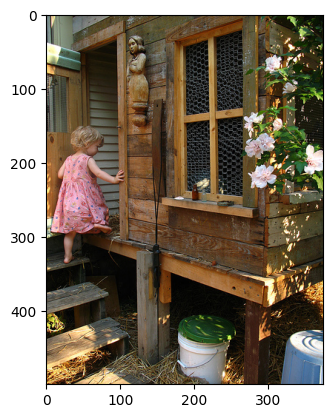

Caption: A child in a pink dress is climbing up a set of stairs in an entry way .
Caption: A girl going into a wooden building .
Caption: A little girl climbing into a wooden playhouse .
Caption: A little girl climbing the stairs to her playhouse .
Caption: A little girl in a pink dress going into a wooden cabin .


In [4]:
image_path = data_location + "/Images/" + df.iloc[0, 0]
img = mpimg.imread(image_path)
plt.imshow(img)
plt.show()

for i in range(5):
    print("Caption:", df.iloc[i,1])

In [5]:
# ! pip3 install spacy
# ! py -m spacy download en_core_web_sm

In [6]:
#using spacy for the better text tokenization 
spacy_eng = spacy.load("en_core_web_sm")

text = "A little girl in a pink dress going into a wooden cabin"
[token.text.lower() for token in spacy_eng.tokenizer(text)]

['a',
 'little',
 'girl',
 'in',
 'a',
 'pink',
 'dress',
 'going',
 'into',
 'a',
 'wooden',
 'cabin']

#### Xây dựng Voc cho mỗi từ, số hóa mỗi từ trong chuỗi

In [7]:
class Vocabulary:
    def __init__(self,freq_threshold):
        # int to string tokens: PAD, start of sentence, end of sentence, unknow token
        self.itos = {0 : "<PAD>", 1 : "<SOS>", 2 : "<EOS>", 3 : "<UNK>"}
        #string to int tokens
        self.stoi = {s:i for i,s in self.itos.items()}

        self.freq_threshold = freq_threshold
        
    def __len__(self): 
        return len(self.itos)
    
    @staticmethod
    def tokenize(text):
        return [token.text.lower() for token in spacy_eng.tokenizer(text)]
    
    def build_vocab(self, sentence_list):
        frequencies = Counter()
        idx = 4
        
        for sentence in sentence_list:
            for word in self.tokenize(sentence):
                frequencies[word] += 1
                
                #add the word to the vocab if it reaches minum frequecy threshold
                if frequencies[word] == self.freq_threshold:
                    self.stoi[word] = idx
                    self.itos[idx] = word
                    idx += 1
    
    def numericalize(self,text):
        tokenized_text = self.tokenize(text)
        return [ self.stoi[token] if token in self.stoi else self.stoi["<UNK>"] for token in tokenized_text ]  

In [341]:
v = Vocabulary(freq_threshold=1)
v.build_vocab(["A little girl in a pink dress going into a wooden cabin"])

print(v.stoi)
print(v.numericalize("A little girl in a pink dress going into a wooden cabin."))

{'<PAD>': 0, '<SOS>': 1, '<EOS>': 2, '<UNK>': 3, 'a': 4, 'little': 5, 'girl': 6, 'in': 7, 'pink': 8, 'dress': 9, 'going': 10, 'into': 11, 'wooden': 12, 'cabin': 13}
[4, 5, 6, 7, 4, 8, 9, 10, 11, 4, 12, 13, 3]


#### Transform ảnh, lấy caption và số hóa mỗi ảnh, tạo voc từ dữ liệu Flickr8k

In [8]:
class FlickrDataset(Dataset):
    def __init__(self, root_dir, captions_file, nrows, skiprows = 0,transform=None,freq_threshold=5):
        self.root_dir = root_dir
        if nrows == None:
            self.df = pd.read_csv(captions_file)
        else:
            self.df = pd.read_csv(captions_file, nrows = nrows*5, skiprows = skiprows*5) # đọc caption 6000 ảnh đầu tiên
            if skiprows != 0:
                self.df.columns =['image', 'caption']
        self.transform = transform
        
        #Get image and caption colum from the dataframe
        self.imgs = self.df["image"]
        self.captions = self.df["caption"]
        
        #Initialize vocabulary and build vocab
        self.vocab = Vocabulary(freq_threshold)
        self.vocab.build_vocab(self.captions.tolist())
        
    
    def __len__(self):
        return len(self.df)
    
    def __getitem__(self,idx):
        caption = self.captions[idx]
        img_name = self.imgs[idx]
        img_location = os.path.join(self.root_dir,img_name)
        img = Image.open(img_location).convert("RGB")
        
        #apply the transfromation to the image
        if self.transform is not None:
            img = self.transform(img)
        
        #numericalize the caption text
        caption_vec = []
        caption_vec += [self.vocab.stoi["<SOS>"]]
        caption_vec += self.vocab.numericalize(caption)
        caption_vec += [self.vocab.stoi["<EOS>"]]
        
        return img, torch.tensor(caption_vec)

In [9]:
def show_image(inp, title=None):
    """Imshow for Tensor."""
    inp = inp.numpy().transpose((1, 2, 0)) # (3, 224, 224) => (224, 224, 3)
    plt.imshow(inp)
    if title is not None:
        plt.title(title)
    plt.pause(0.001)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


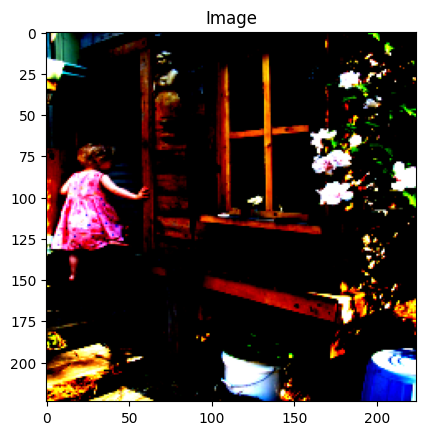

Token: tensor([  1,   4,  28,   8,   4, 195, 151,  17,  32,  67,   4, 353,  11, 711,
          8,  24,   3, 496,   5,   2])
Sentence:
['<SOS>', 'a', 'child', 'in', 'a', 'pink', 'dress', 'is', 'climbing', 'up', 'a', 'set', 'of', 'stairs', 'in', 'an', '<UNK>', 'way', '.', '<EOS>']


In [10]:
#defing the transform to be applied
# transforms = T.Compose([
#     T.Resize((224,224)),
#     T.ToTensor()                             
# ])

transforms = T.Compose([
    T.Resize((226,226)),                   
    T.RandomCrop((224, 224)),                 
    T.ToTensor(), # convert a PIL image or ndarray to tensor.                               
    T.Normalize((0.485, 0.456, 0.406),(0.229, 0.224, 0.225))
])

alldata =  FlickrDataset(
    root_dir = data_location + "\\Images",
    captions_file = data_location + "\\captions.txt",
    nrows = None,
    transform = transforms
)

#testing the dataset class
dataset =  FlickrDataset(
    root_dir = data_location + "\\Images",
    captions_file = data_location + "\\captions.txt",
    nrows = 7000, #3000 7000 200
    transform = transforms
)

datatest = FlickrDataset(
    root_dir = data_location + "\\Images",
    captions_file = data_location + "\\captions.txt",
    skiprows = 7000, #3000, 7000, 200
    nrows = 1000,
    transform = transforms
)

img, caps = dataset[0]
show_image(img,"Image")
print("Token:",caps)
print("Sentence:")
print([dataset.vocab.itos[token] for token in caps.tolist()])

#### Thêm PAD vào caption để mẫu cùng kích thước

In [11]:
class CapsCollate:
    """
    Collate to apply the padding to the captions with dataloader
    """
    def __init__(self, pad_idx, batch_first = False):
        self.pad_idx = pad_idx
        self.batch_first = batch_first
    
    def __call__(self, batch):
        # print("batch ", batch.shape)
        imgs = [item[0].unsqueeze(0) for item in batch] # (3, 224, 224) => (1, 3, 224, 224) each item
        imgs = torch.cat(imgs, dim=0) # => (4, 3, 224, 224)
        
        targets = [item[1] for item in batch] # size 4
        targets = pad_sequence(targets, batch_first = self.batch_first, padding_value = self.pad_idx) # thêm padding để sequence bằng max size list of targets
        return imgs,targets

In [12]:
BATCH_SIZE = 64
# BATCH_SIZE = 4
NUM_WORKER = 0

#token to represent the padding
pad_idx = dataset.vocab.stoi["<PAD>"]

# Tạo batch data để đưa vào model
# Tính loss trên mỗi batch, tránh overfitting, không ghi nhớ hết mà học đặc trưng tổng quát mỗi batch

data_loader = DataLoader(
    dataset = dataset,
    batch_size = BATCH_SIZE,
    num_workers = NUM_WORKER, # a main process
    shuffle = True, # xáo trộn trong mỗi epoch
    collate_fn = CapsCollate(pad_idx = pad_idx, batch_first=True) # return batch data
)

test_loader = DataLoader(
    dataset = datatest,
    batch_size = 1,
    num_workers = NUM_WORKER, # a main process
    # shuffle = True, # xáo trộn trong mỗi epoch
    collate_fn = CapsCollate(pad_idx = pad_idx, batch_first=True) # return batch data
)

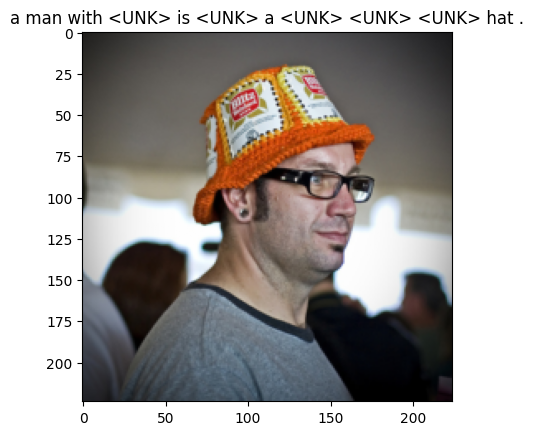

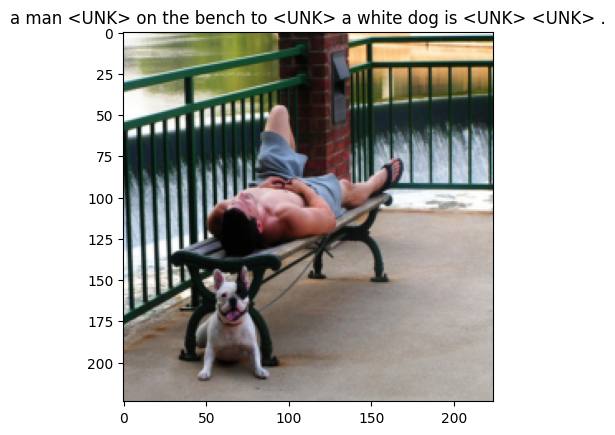

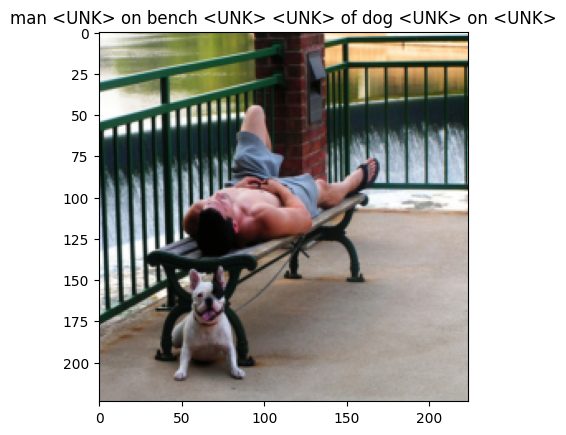

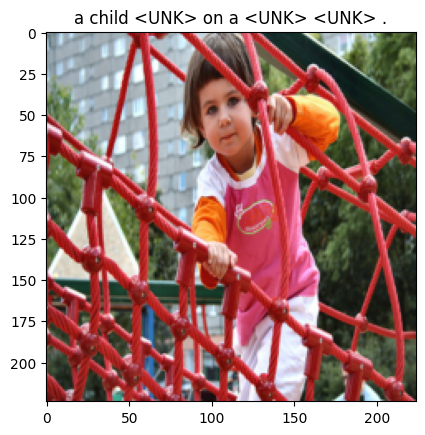

In [347]:
# lặp qua batch trong data_loader
dataiter = iter(data_loader)
#get next batch
batch = next(dataiter)
#unpacking the batch
images, captions = batch
#showing info of image in single batch
for i in range(BATCH_SIZE):
    img, cap = images[i], captions[i]
    caption_label = [dataset.vocab.itos[token] for token in cap.tolist()]
    eos_index = caption_label.index('<EOS>')
    caption_label = caption_label[1:eos_index]
    caption_label = ' '.join(caption_label)                      
    show_image(img, caption_label)
    plt.show()

In [13]:
# show the tensor image
def show_image(img, title=None):
    
    #unnormalize 
    img[0] = img[0] * 0.229
    img[1] = img[1] * 0.224 
    img[2] = img[2] * 0.225 
    img[0] += 0.485 
    img[1] += 0.456 
    img[2] += 0.406
    
    img = img.numpy().transpose((1, 2, 0))
    
    
    plt.imshow(img)
    if title is not None:
        plt.title(title)
    plt.pause(0.001)  # pause a bit so that plots are updated

## Model with ResNet, Attention, LSTM

In [14]:
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torchvision.models as models

ResNet sử dụng các residual block để giữ nguyên giá trị đầu vào của một số lớp, cho phép thông tin lan truyền từ lớp này sang lớp khác một cách dễ dàng hơn, giảm thiểu hiện tượng vanishing gradient.

In [15]:
class EncoderCNN(nn.Module):
    def __init__(self):
        super(EncoderCNN, self).__init__()
        # (batch_size, channels, height, width)
        resnet = models.resnet50(weights=models.ResNet50_Weights.IMAGENET1K_V1)
        for param in resnet.parameters():
            param.requires_grad_(False)
        
        modules = list(resnet.children())[:-2]
        self.resnet = nn.Sequential(*modules)
        

    def forward(self, images):
        # [64, 2048, 7, 7]
        features = self.resnet(images)  
        #(batch_size,7,7,2048) [64, 7, 7, 2048]                               
        features = features.permute(0, 2, 3, 1)                           
        #(batch_size,49,2048) [64, 49, 2048]
        features = features.view(features.size(0), -1, features.size(-1)) 
        return features

In [16]:
# Bahdanau Attention
# Nhận feature từ CNN => attention vector

class Attention(nn.Module):
    def __init__(self, encoder_dim,decoder_dim,attention_dim):
        super(Attention, self).__init__()
        
        # 256
        self.attention_dim = attention_dim
        
        self.W = nn.Linear(decoder_dim,attention_dim)
        self.U = nn.Linear(encoder_dim,attention_dim)
        self.A = nn.Linear(attention_dim,1)
        
        
    def forward(self, features, hidden_state):
        # [64, 49, 256]
        u_hs = self.U(features)     # (batch_size, num_layers, attention_dim)
        # [64, 256]
        w_ah = self.W(hidden_state) # (batch_size, attention_dim)
        
        # [64, 49, 256], e = f(h, z) range values [-1, 1]
        combined_states = torch.tanh(u_hs + w_ah.unsqueeze(1)) # (batch_size, num_layers, attemtion_dim)
        # [64, 49, 1]
        attention_scores = self.A(combined_states)         # (batch_size, num_layers, 1)
        # [64, 49]
        attention_scores = attention_scores.squeeze(2)     # (batch_size, num_layers)1
        
        # a: a = softmax(e), range values [0, 1]
        # [64, 49]
        alpha = F.softmax(attention_scores,dim=1)          # (batch_size, num_layers)
        
        # c: c = Sigma (z.a)
        # [64, 49, 2048]
        attention_weights = features * alpha.unsqueeze(2)  # (batch_size, num_layers, features_dim)
        # [64, 2048], tổng các features_dim
        attention_weights = attention_weights.sum(dim=1)   # (batch_size, num_layers)
        
        return alpha, attention_weights # return [64, 49], [64, 2048]

In [17]:
#Attention Decoder
# Tạo caption mô tả ảnh với RNN

class DecoderRNN(nn.Module):
    def __init__(self,embed_size, vocab_size, attention_dim,encoder_dim,decoder_dim,drop_prob=0.3):
        super().__init__()
        
        #save the model param
        self.vocab_size = vocab_size
        self.attention_dim = attention_dim
        self.decoder_dim = decoder_dim
        
        # embedding ánh xạ voc từ vựng sang embedding vector số thực
        self.embedding = nn.Embedding(vocab_size,embed_size)
        # from [2048, 512, 256]
        self.attention = Attention(encoder_dim, decoder_dim, attention_dim)
        
        # linear is considered FCNN
        # connect word vector with image vector
        # Linear ánh xạ encoder_dim sang decoder_dim qua biến đổi tuyến tính [0, 1], giảm chiều
        self.init_h = nn.Linear(encoder_dim, decoder_dim)  
        self.init_c = nn.Linear(encoder_dim, decoder_dim)  
        self.lstm_cell = nn.LSTMCell(embed_size+encoder_dim,decoder_dim,bias=True) # reduce vanishing problem
        self.f_beta = nn.Linear(decoder_dim, encoder_dim)
        
        
        self.fcn = nn.Linear(decoder_dim,vocab_size)
        self.drop = nn.Dropout(drop_prob) # kỹ thuật regularization, reduce overfitting
        
        
    
    def forward(self, features, captions):
        
        # vectorize the caption
        # [64, 42, 300]
        embeds = self.embedding(captions)

        # Initialize LSTM state
        # [64, 512] (batch_size, decoder_dim)
        h, c = self.init_hidden_state(features)
        
        #get the seq length to iterate
        seq_length = len(captions[0])-1 #Exclude the last one
        # 64
        batch_size = captions.size(0)

        # 49
        num_features = features.size(1)
        
        # [64, len(captions), 2775] with 0
        preds = torch.zeros(batch_size, seq_length, self.vocab_size).to(device)
        # [64, len(captions), 49] with 0
        alphas = torch.zeros(batch_size, seq_length, num_features).to(device)
                
        for s in range(seq_length):
            # attention
            # a (alpha), c (context) - c(t) = a(t).z(t) from z (features), e (h)
            # [64, 49], [64, 2048]
            alpha, context = self.attention(features, h) # context is weight sum of output CNN

            # from y (embeds) [64, 300], c (context) [64, 2048] => [64, 2348]
            lstm_input = torch.cat((embeds[:, s], context), dim=1) # use to predict next word
            
            # from y , c, h, return same [64, 512]
            h, c = self.lstm_cell(lstm_input, (h, c))
            # update context is h
            
            # [64, 2775] for y pred
            output = self.fcn(self.drop(h))
            
            preds[:,s] = output
            alphas[:,s] = alpha  
        
        return preds, alphas
    
    def generate_caption(self,features,max_len=20,vocab=None):
        # Inference part
        # Given the image features generate the captions
        
        batch_size = features.size(0)
        h, c = self.init_hidden_state(features)  # (batch_size, decoder_dim)
        
        alphas = []
        
        #starting input
        word = torch.tensor(vocab.stoi['<SOS>']).view(1,-1).to(device)
        embeds = self.embedding(word)

        
        captions = []
        
        for i in range(max_len):
            alpha,context = self.attention(features, h)
            
            
            #store the apla score
            alphas.append(alpha.cpu().detach().numpy())
            
            lstm_input = torch.cat((embeds[:, 0], context), dim=1)
            h, c = self.lstm_cell(lstm_input, (h, c))
            output = self.fcn(self.drop(h))
            output = output.view(batch_size,-1)
        
            
            #select the word with most val
            predicted_word_idx = output.argmax(dim=1)
            
            #save the generated word
            captions.append(predicted_word_idx.item())
            
            #end if <EOS detected>
            if vocab.itos[predicted_word_idx.item()] == "<EOS>":
                break
            
            #send generated word as the next caption
            embeds = self.embedding(predicted_word_idx.unsqueeze(0))
        
        #covert the vocab idx to words and return sentence
        return [vocab.itos[idx] for idx in captions],alphas
    
    
    def init_hidden_state(self, encoder_out):
        # [64, 49, 2048] => [64, 2048], tb cộng channels
        mean_encoder_out = encoder_out.mean(dim=1)
        # [64, 512]
        h = self.init_h(mean_encoder_out)  # (batch_size, decoder_dim)
        # [64, 512]
        c = self.init_c(mean_encoder_out)
        return h, c

In [18]:
class EncoderDecoder(nn.Module):
    def __init__(self,embed_size, vocab_size, attention_dim,encoder_dim,decoder_dim,drop_prob=0.3):
        super().__init__()
        self.encoder = EncoderCNN()
        self.decoder = DecoderRNN(
            embed_size=embed_size,
            vocab_size = len(dataset.vocab),
            attention_dim=attention_dim,
            encoder_dim=encoder_dim,
            decoder_dim=decoder_dim
        )
        
    def forward(self, images, captions):
        # [64, 49, 2048]
        features = self.encoder(images)
        outputs = self.decoder(features, captions)
        return outputs

In [53]:
# #Attention Decoder
# # Tạo caption mô tả ảnh với RNN

# class DecoderWithoutAttention(nn.Module):
#     def __init__(self,embed_size, vocab_size, attention_dim,encoder_dim,decoder_dim,drop_prob=0.3):
#         super().__init__()
        
#         #save the model param
#         self.vocab_size = vocab_size
#         self.attention_dim = attention_dim
#         self.decoder_dim = decoder_dim
        
#         # embedding ánh xạ voc từ vựng sang embedding vector số thực
#         self.embedding = nn.Embedding(vocab_size,embed_size)
#         # from [2048, 512, 256]
#         self.attention = Attention(encoder_dim, decoder_dim, attention_dim)
        
#         # linear is considered FCNN
#         # connect word vector with image vector
#         # Linear ánh xạ encoder_dim sang decoder_dim qua biến đổi tuyến tính [0, 1], giảm chiều
#         self.init_h = nn.Linear(encoder_dim, decoder_dim)  
#         self.init_c = nn.Linear(encoder_dim, decoder_dim)  
#         self.lstm_cell = nn.LSTMCell(embed_size+encoder_dim,decoder_dim,bias=True) # reduce vanishing problem
#         self.f_beta = nn.Linear(decoder_dim, encoder_dim)
        
        
#         self.fcn = nn.Linear(decoder_dim,vocab_size)
#         self.drop = nn.Dropout(drop_prob) # kỹ thuật regularization, reduce overfitting
        
        
    
#     def forward(self, features, captions):
        
#         # vectorize the caption
#         # [64, 42, 300]
#         embeds = self.embedding(captions)

#         # Initialize LSTM state
#         # features: [64, 3, 224, 224]
#         # [64, 512] (batch_size, decoder_dim)
#         print("features", features.shape)
#         h, c = self.init_hidden_state(features)
        
#         #get the seq length to iterate
#         seq_length = len(captions[0])-1 #Exclude the last one
#         # 64
#         batch_size = captions.size(0)

#         # 49
#         num_features = features.size(1)
        
#         # [64, len(captions), 2775] with 0
#         preds = torch.zeros(batch_size, seq_length, self.vocab_size).to(device)
#         # [64, len(captions), 49] with 0
#         # alphas = torch.zeros(batch_size, seq_length, num_features).to(device)

#         for s in range(seq_length):
#             # attention
#             # a (alpha), c (context) - c(t) = a(t).z(t) from z (features), e (h)
#             # [64, 49], [64, 2048]
#             # alpha, context = self.attention(features, h) # context is weight sum of output CNN

#             # from y (embeds) [64, 300], c (context) [64, 512] => [64, 812]
#             lstm_input = torch.cat((embeds[:, s], h), dim=1) # use to predict next word
#             print("lstm_input", lstm_input.shape)
            
#             # from y , c, h, return same [64, 512]
#             h, c = self.lstm_cell(lstm_input, (h, c))
#             # update context is h
            
#             # [64, 2775] for y pred
#             output = self.fcn(self.drop(h))
            
#             preds[:,s] = output
#             # alphas[:,s] = alpha  
        
#         return preds #, alphas
    
#     def generate_caption(self,features,max_len=20,vocab=None):
#         # Inference part
#         # Given the image features generate the captions
        
#         batch_size = features.size(0)
        
#         h, c = self.init_hidden_state(features)  # (batch_size, decoder_dim)
        
#         alphas = []
        
#         #starting input
#         word = torch.tensor(vocab.stoi['<SOS>']).view(1,-1).to(device)
#         embeds = self.embedding(word)

        
#         captions = []
        
#         for i in range(max_len):
#             # alpha,context = self.attention(features, h)
            
            
#             #store the apla score
#             # alphas.append(alpha.cpu().detach().numpy())
            
#             lstm_input = torch.cat((embeds[:, 0], h), dim=1)
#             h, c = self.lstm_cell(lstm_input, (h, c))
#             output = self.fcn(self.drop(h))
#             output = output.view(batch_size,-1)
        
            
#             #select the word with most val
#             predicted_word_idx = output.argmax(dim=1)
            
#             #save the generated word
#             captions.append(predicted_word_idx.item())
            
#             #end if <EOS detected>
#             if vocab.itos[predicted_word_idx.item()] == "<EOS>":
#                 break
            
#             #send generated word as the next caption
#             embeds = self.embedding(predicted_word_idx.unsqueeze(0))
        
#         #covert the vocab idx to words and return sentence
#         return [vocab.itos[idx] for idx in captions],alphas
    
    
#     def init_hidden_state(self, encoder_out):
#         # [64, 224, 224] => [64, 2048], tb cộng channels
#         mean_encoder_out = encoder_out.mean(dim=1)
#         print("mean_encoder_out",mean_encoder_out.shape)
#         # [64, 512]
#         h = self.init_h(mean_encoder_out)  # (batch_size, decoder_dim)
#         # [64, 512]
#         c = self.init_c(mean_encoder_out)
#         return h, c

In [54]:
# class Output(nn.Module):
#     def __init__(self,embed_size, vocab_size, attention_dim,encoder_dim,decoder_dim,drop_prob=0.3):
#         super().__init__()
#         self.encoder = EncoderCNN()
#         self.decoder = DecoderWithoutAttention(
#             embed_size=embed_size,
#             vocab_size = len(dataset.vocab),
#             attention_dim=attention_dim,
#             encoder_dim=encoder_dim,
#             decoder_dim=decoder_dim
#         )
        
#     def forward(self, images, captions):
#         # [64, 49, 2048]
#         features = self.encoder(images)
#         print("features-encode", features.shape)
#         outputs = self.decoder(features, captions)
#         return outputs

In [55]:
# #init model
# model = Output(
#     embed_size=300,
#     vocab_size = len(dataset.vocab),
#     attention_dim=256,
#     encoder_dim=512,
#     decoder_dim=128
# ).to(device)

# criterion = nn.CrossEntropyLoss(ignore_index=dataset.vocab.stoi["<PAD>"])
# # thuật toán tối ưu mới như Adam, RMSprop, Adagrad để cập nhật tham số mô hình một cách hiệu quả và giảm tối đa tình trạng vanishing gradient.
# optimizer = optim.Adam(model.parameters(), lr=learning_rate)

In [ ]:
# # full v3
# # batch size 64
# # dataset 35000
# # data_loader 547

# num_epochs = 2
# print_every = 1
# losses = []
# loss_each_epoch = []

# for epoch in range(1,num_epochs+1):   
#     for idx, (image, captions) in enumerate(iter(data_loader)):
#         image, captions = image.to(device),captions.to(device)

#         # Zero the gradients.
#         optimizer.zero_grad()

#         # Feed forward
#         outputs = model(image, captions)

#         # Calculate the batch loss.
#         targets = captions[:,1:]
#         loss = criterion(outputs.view(-1, vocab_size), targets.reshape(-1))
        
#         # Backward pass.
#         loss.backward()
#         losses.append(loss.item())

#         # Update the parameters in the optimizer.
#         optimizer.step()

#         if (idx + 1)%print_every == 0:
#             print("Epoch: {} loss: {:.5f}".format(epoch,loss.item()))
#             loss_each_epoch.append(loss.item())
#             references = []
#             hypotheses = []
            
#             #generate the caption
#             model.eval()
#             with torch.no_grad():
#                 dataiter = iter(data_loader)
#                 img, cap = next(dataiter) # (64, 3, 224, 224)
#                 features = model.encoder(img[0:1].to(device))
#                 caps,alphas = model.decoder.generate_caption(features,vocab=dataset.vocab)
#                 caption = ' '.join(caps)
#                 print("caption: ", caption)

#                 reference = [dataset.vocab.itos[token] for token in cap.tolist()[0]]
#                 i = 0
#                 while i < len(reference):
#                     if reference[i] == '<PAD>':
#                         del reference[i]
#                     else:
#                         i += 1
#                 references.append(reference)
#                 hypotheses.append(caps)
                
#                 caption_label = [dataset.vocab.itos[token] for token in cap[0].tolist()]
#                 eos_index = caption_label.index('<EOS>')
#                 caption_label = caption_label[1:eos_index]
#                 caption_label = ' '.join(caption_label)   
#                 print("# Original Caption:",caption_label)

#                 bleu_score = nltk.translate.bleu_score.corpus_bleu(references, hypotheses, smoothing_function=smoothie)
#                 print("BLEU score: {:.4f}".format(bleu_score))

#                 show_image(img[0],title=caption)

            
#             model.train()
        
#     #save the latest model
#     # save_model(model,epoch)

## Run with 3000, 7000 images

In [21]:
vocab_size = len(dataset.vocab)
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
device

device(type='cuda', index=0)

In [23]:
print(len(dataset))
print(len(datatest))

35000
5000


In [40]:
embed_size=300
vocab_size = len(dataset.vocab)
attention_dim=256
encoder_dim=2048
decoder_dim=512
learning_rate = 3e-4

#init model
model = EncoderDecoder(
    embed_size=300,
    vocab_size = len(dataset.vocab),
    attention_dim=256,
    encoder_dim=2048,
    decoder_dim=512
).to(device)

criterion = nn.CrossEntropyLoss(ignore_index=dataset.vocab.stoi["<PAD>"])
# thuật toán tối ưu mới như Adam, RMSprop, Adagrad để cập nhật tham số mô hình một cách hiệu quả và giảm tối đa tình trạng vanishing gradient.
optimizer = optim.Adam(model.parameters(), lr=learning_rate)

In [20]:
#helper function to save the model
def save_model(model,num_epochs):
    model_state = {
        'num_epochs':num_epochs,
        'embed_size':embed_size,
        'vocab_size':len(dataset.vocab),
        'attention_dim':attention_dim,
        'encoder_dim':encoder_dim,
        'decoder_dim':decoder_dim,
        'state_dict':model.state_dict()
    }

    torch.save(model_state,'attention_model_state_v3.pth')

In [25]:
print(len(data_loader))
print(len(test_loader))

547
5000


### 7000 v3

Epoch: 1 loss: 3.74444
caption:  a black dog is running through the grass . <EOS>
# Original Caption: a black dog runs through the dry grass .
BLEU score: 0.0279


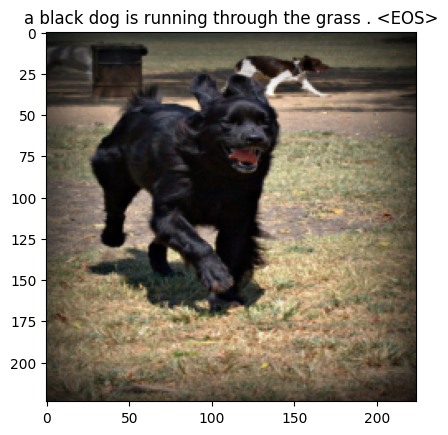

Epoch: 2 loss: 3.12687
caption:  a white bird is flying through the water . <EOS>
# Original Caption: a large white bird flies out of the water .
BLEU score: 0.0279


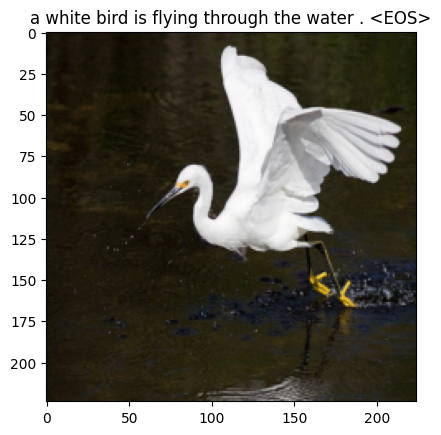

Epoch: 3 loss: 2.92769
caption:  a black dog is jumping over a ball . <EOS>
# Original Caption: a black dog looks up at a white ball that 's in midair .
BLEU score: 0.0279


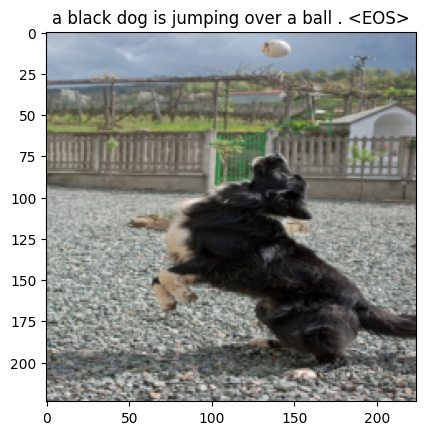

Epoch: 4 loss: 2.62108
caption:  a girl in a red shirt and red shirt is playing in a red slide . <EOS>
# Original Caption: young girl in tunnel slide
BLEU score: 0.0000


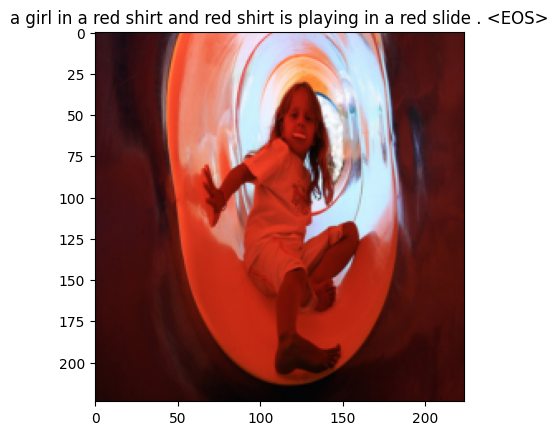

Epoch: 5 loss: 2.44082
caption:  a group of people are sitting on a skateboard . <EOS>
# Original Caption: spectators watch as a snowboarder does a trick .
BLEU score: 0.0257


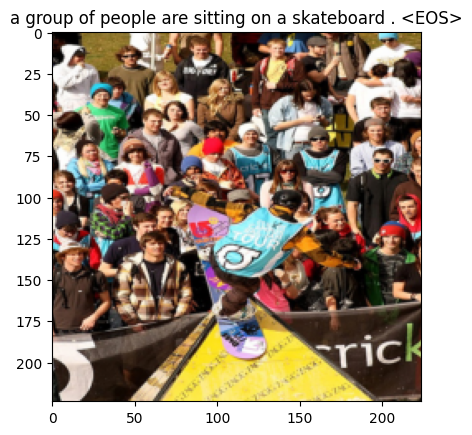

Epoch: 6 loss: 2.23550
caption:  a white dog is running through the water . <EOS>
# Original Caption: a dog retrieves a stick from a body of water .
BLEU score: 0.0279


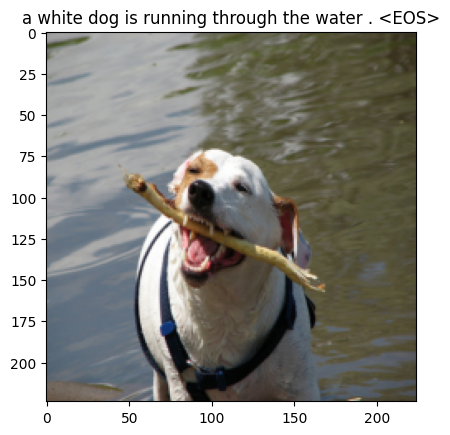

Epoch: 7 loss: 2.06053
caption:  a man in a cowboy hat and a cowboy hat on a horse . <EOS>
# Original Caption: a person is kneeling between two horses
BLEU score: 0.0166


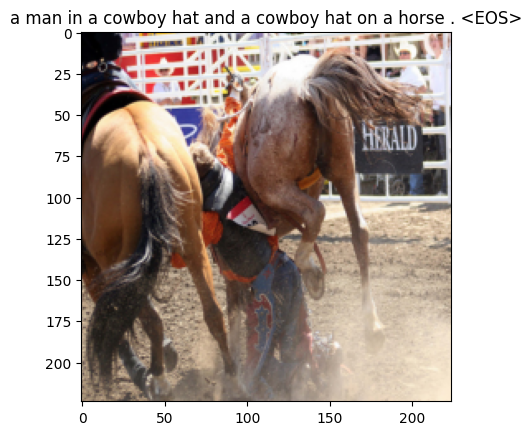

Epoch: 8 loss: 1.95642
caption:  a man in a red shirt is walking down a street . <EOS>
# Original Caption: man carrying his shoulder bag walking down the street .
BLEU score: 0.0223


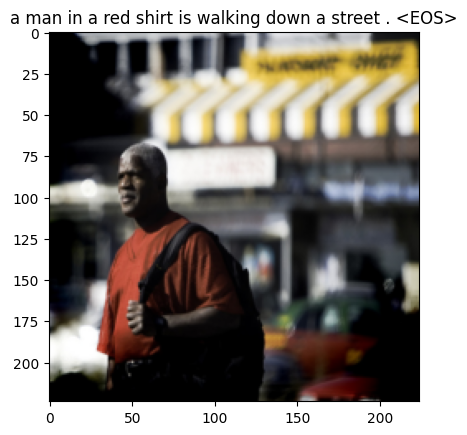

Epoch: 9 loss: 1.93312
caption:  a man in a white shirt and black pants is standing on a stone wall . <EOS>
# Original Caption: elderly man sitting in a doorway .
BLEU score: 0.0178


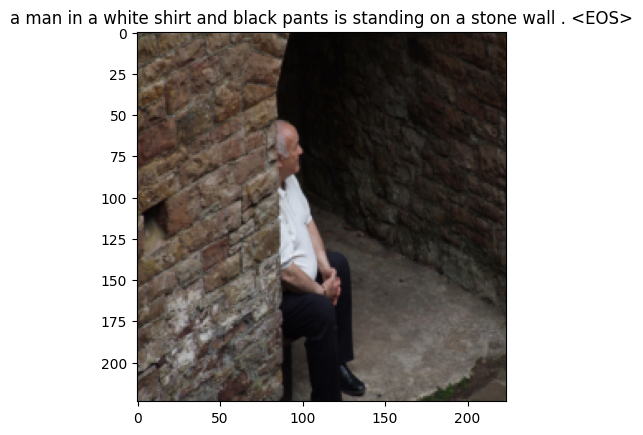

Epoch: 10 loss: 1.89836
caption:  a man and a woman in a suit . <EOS>
# Original Caption: a serious looking young man with a suit holds a cellphone .
BLEU score: 0.0279


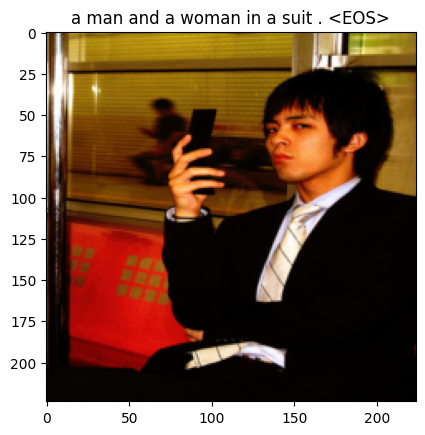

Epoch: 11 loss: 1.96126
caption:  a man is standing on a drum while another man watches . <EOS>
# Original Caption: a group of men hold a drum over their heads with a man standing on it .
BLEU score: 0.0223


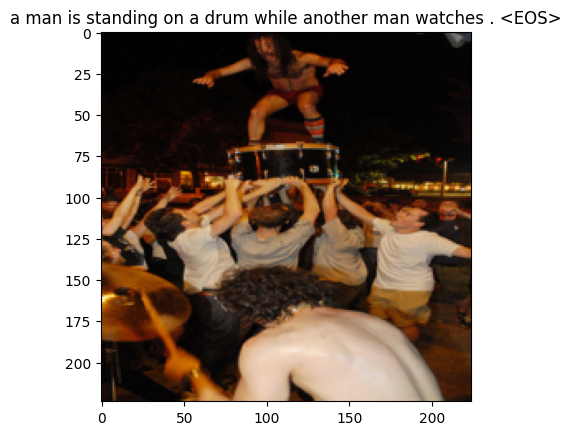

Epoch: 12 loss: 1.79016
caption:  a child with a blue shirt is smiling . <EOS>
# Original Caption: child in blue shirt smiles about what 's in his hand .
BLEU score: 0.0279


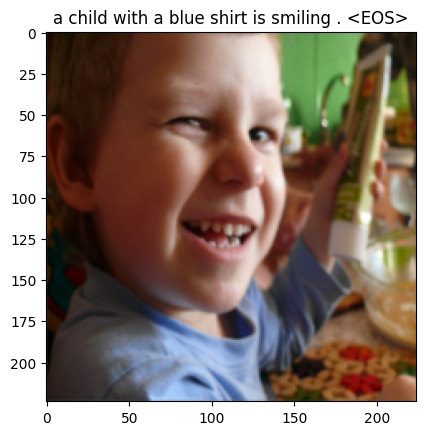

Epoch: 13 loss: 1.75949
caption:  a brown dog is running through the grass . <EOS>
# Original Caption: orange dog runs across grass .
BLEU score: 0.0279


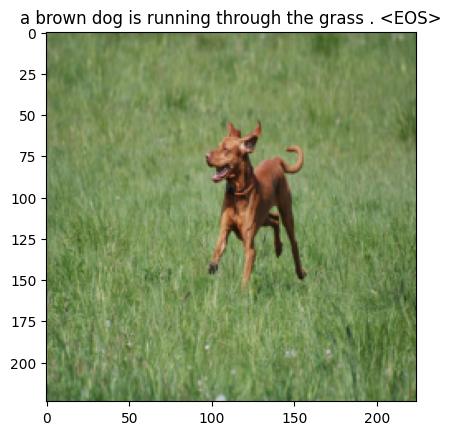

Epoch: 14 loss: 1.54761
caption:  a group of people are standing together and <UNK> on the phone . <EOS>
# Original Caption: a group of girls stands wearing jean skirts and superman shirts .
BLEU score: 0.0209


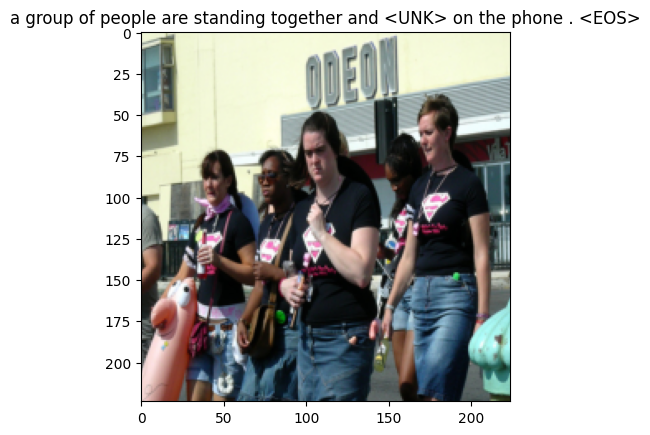

Epoch: 15 loss: 1.64665
caption:  a young girl in a white shirt is holding up a tree in the air . <EOS>
# Original Caption: a girl in a gray <UNK> is throwing her hands up .
BLEU score: 0.0178


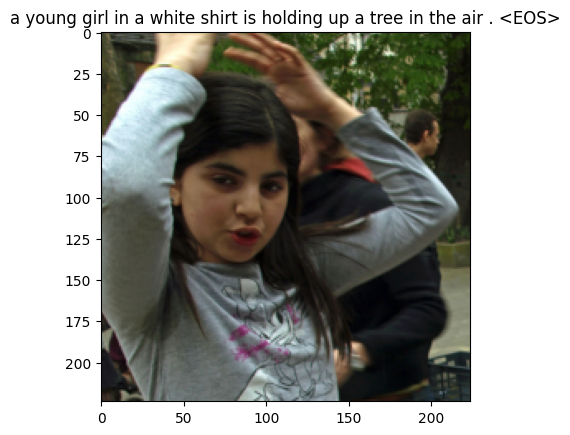

Epoch: 16 loss: 1.54498
caption:  a snowboarder is jumping over a snow covered hill . <EOS>
# Original Caption: a snowboarder makes a jump against a wooded background .
BLEU score: 0.0284


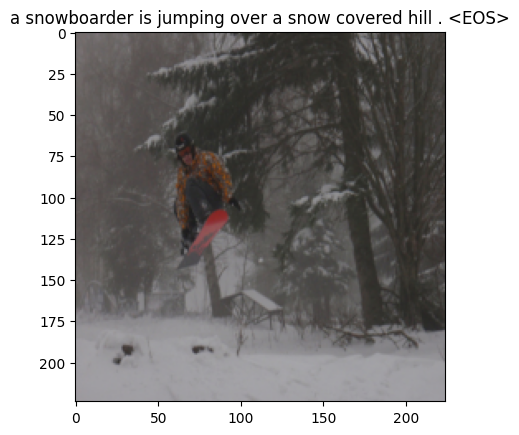

Epoch: 17 loss: 1.47239
caption:  a black dog is jumping over a woman with a black dog in the background . <EOS>
# Original Caption: woman running after dog
BLEU score: 0.0149


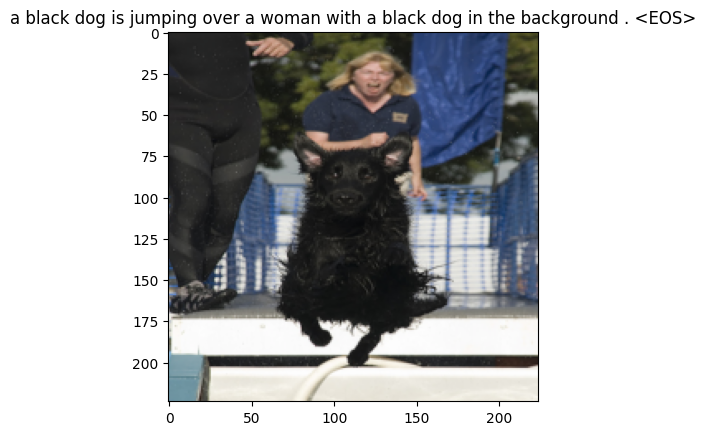

Epoch: 18 loss: 1.49028
caption:  a black and white dog bounds through tall grass . <EOS>
# Original Caption: a white and black dog leaps through long grass in a field .
BLEU score: 0.0257


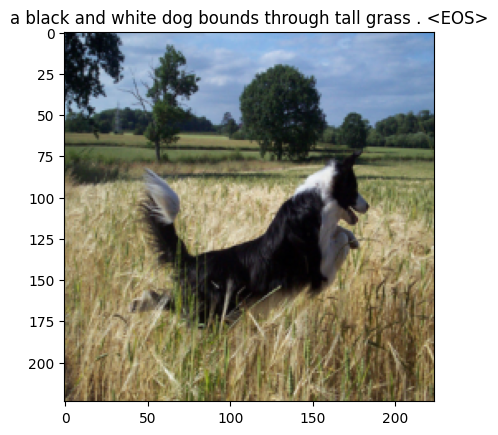

Epoch: 19 loss: 1.48941
caption:  a man in a black shirt is standing in a gym . <EOS>
# Original Caption: a man in a black jersey is standing in gym .
BLEU score: 0.0223


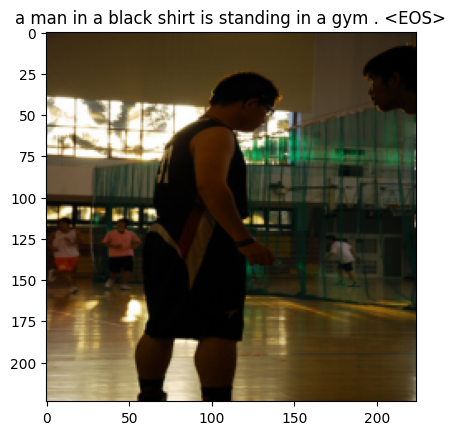

Epoch: 20 loss: 1.41584
caption:  a boy in a brown hat is carrying a soccer ball . <EOS>
# Original Caption: a child dressed in a blue shirt and cap is carrying a soccer ball .
BLEU score: 0.0223


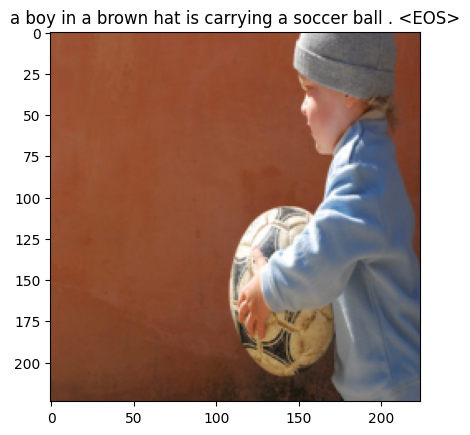

Epoch: 21 loss: 1.29040
caption:  a dog runs through a field . <EOS>
# Original Caption: a miniature breed dog is running in a straw strewn field .
BLEU score: 0.0340


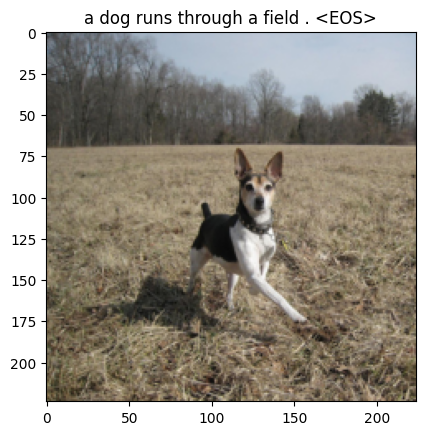

Epoch: 22 loss: 1.27203
caption:  football players in red and white uniforms are jumping in front of a crowd of people . <EOS>
# Original Caption: oklahoma <UNK> football players on the field .
BLEU score: 0.0169


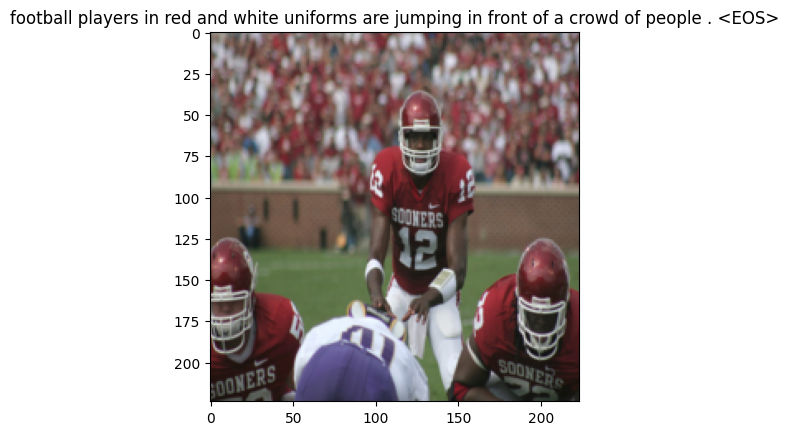

Epoch: 23 loss: 1.36482
caption:  wet wet dog running through water <EOS>
# Original Caption: a wet dog is splashing through shallow water .
BLEU score: 0.0000


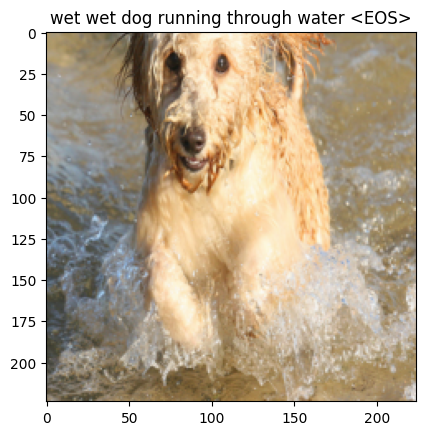

Epoch: 24 loss: 1.20233
caption:  a dog running in the water . <EOS>
# Original Caption: a dog running in the water .
BLEU score: 0.0340


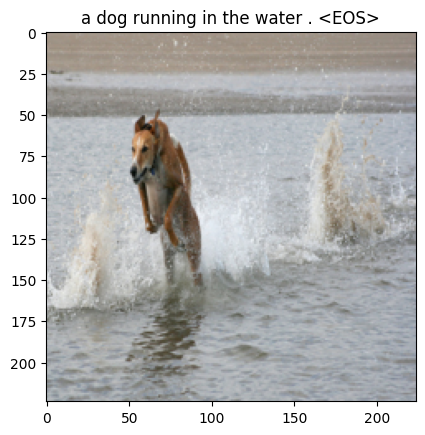

Epoch: 25 loss: 1.11730
caption:  two women in <UNK> <UNK> near a cow . <EOS>
# Original Caption: two <UNK> asian women sitting outdoors behind a cow - like animal
BLEU score: 0.0235


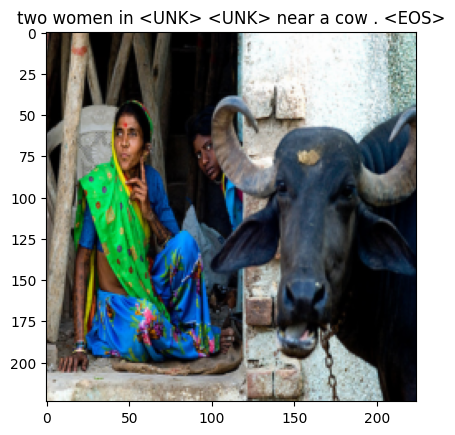

Epoch: 26 loss: 1.20059
caption:  a man wakeboards in a green boat . <EOS>
# Original Caption: a kite surfer begins to fall in the ocean .
BLEU score: 0.0306


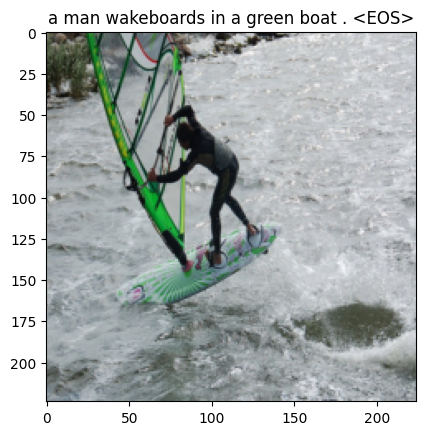

Epoch: 27 loss: 1.18181
caption:  a boy in black slides headfirst down a metal tube <EOS>
# Original Caption: a little boy in black slides headfirst down a tan tube with his mouth open wide .
BLEU score: 0.0216


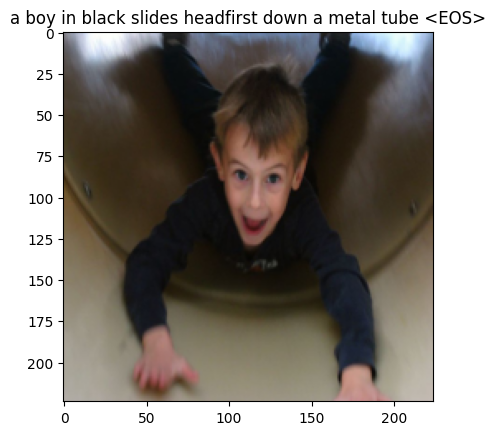

Epoch: 28 loss: 1.00606
caption:  a woman with a british , and a hat with her head on her head . <EOS>
# Original Caption: girl with a large hat with the british flag on it .
BLEU score: 0.0178


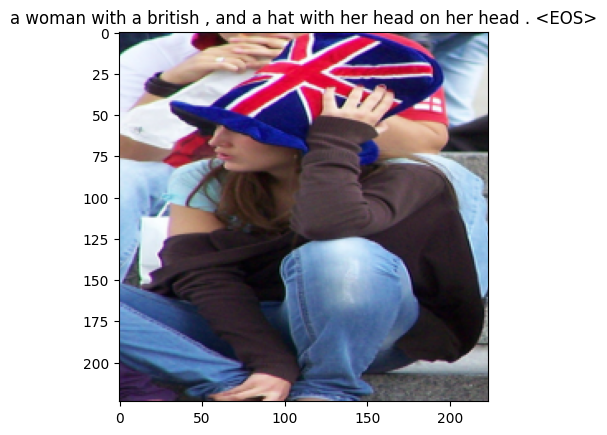

Epoch: 29 loss: 1.07430
caption:  three people posing on a brick wall <EOS>
# Original Caption: three people climbing rocks .
BLEU score: 0.0000


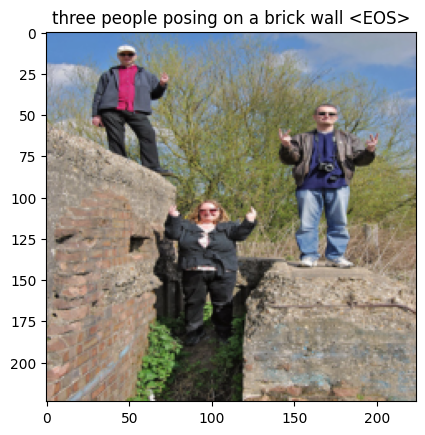

Epoch: 30 loss: 0.98644
caption:  a football player is kicking the ball while another player runs towards the ball . <EOS>
# Original Caption: a football player is kicking the ball while the opposing fans watch .
BLEU score: 0.0187


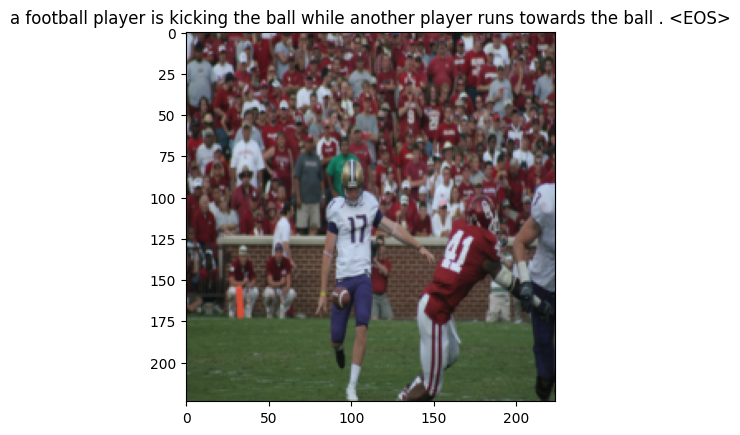

Epoch: 31 loss: 0.91903
caption:  a woman holding a baby in a <UNK> on her chest . <EOS>
# Original Caption: a woman is carrying a sleeping baby in a <UNK> on her chest .
BLEU score: 0.0223


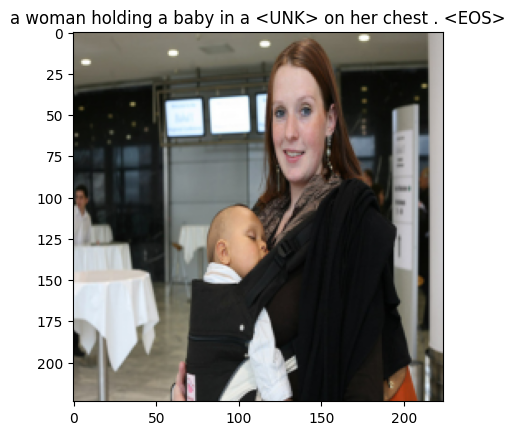

Epoch: 32 loss: 0.98143
caption:  a man and a woman are smiling . <EOS>
# Original Caption: the man and woman are both smiling .
BLEU score: 0.0306


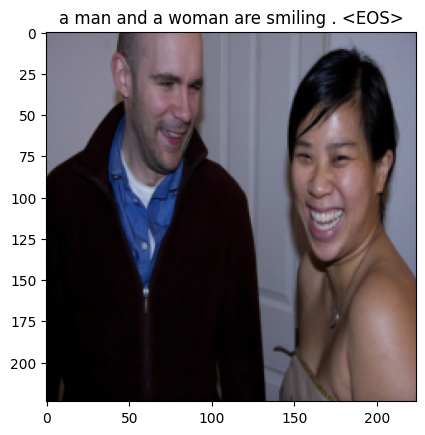

Epoch: 33 loss: 0.96077
caption:  a man and a woman pose for a picture . <EOS>
# Original Caption: a man and a woman smile for the camera .
BLEU score: 0.0284


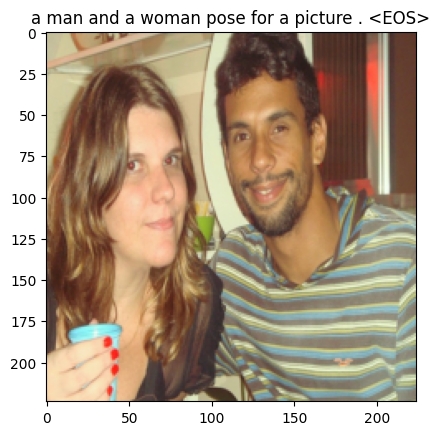

Epoch: 34 loss: 0.80710
caption:  a white and black dog is running out of a yellow and orange tube . <EOS>
# Original Caption: a husky dog running through a yellow tunnel at an obstacle course .
BLEU score: 0.0187


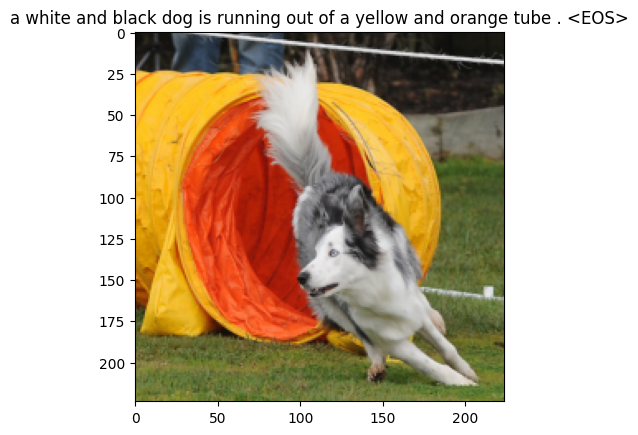

Epoch: 35 loss: 0.81060
caption:  a bunch of people rowing a canoe , with a boat in the background . <EOS>
# Original Caption: <UNK> racing <UNK> .
BLEU score: 0.0187


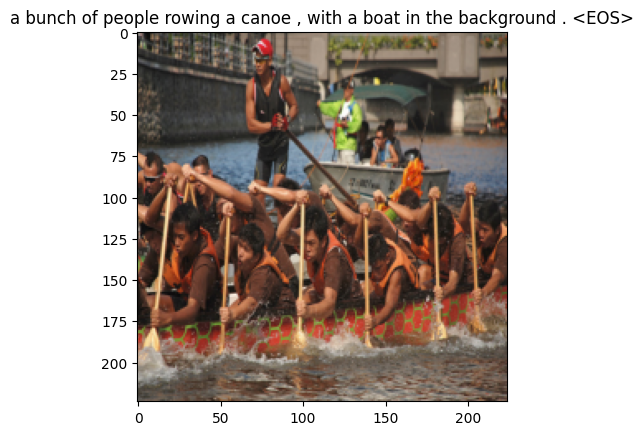

Epoch: 36 loss: 0.81432
caption:  a person wearing a black jacket climbs up a large rock . <EOS>
# Original Caption: a man wearing a backpack is climbing a rock .
BLEU score: 0.0246


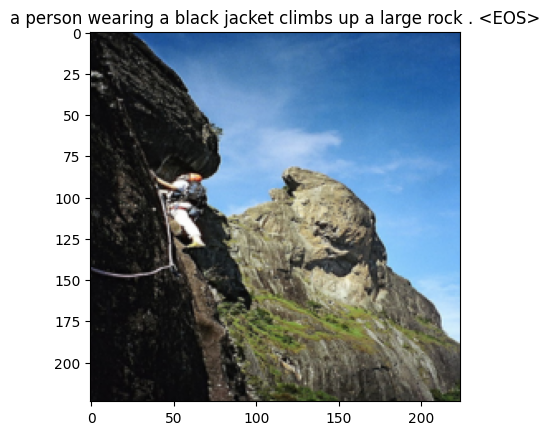

Epoch: 37 loss: 0.88031
caption:  woman with two medals around her neck , holding up seven fingers . <EOS>
# Original Caption: woman wearing two gold medals holding up her hands .
BLEU score: 0.0176


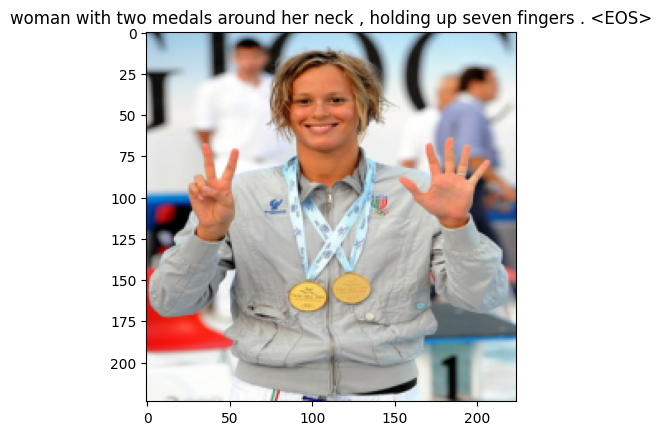

Epoch: 38 loss: 0.80997
caption:  a person in a blue jacket is climbing a rock in a forest . <EOS>
# Original Caption: a person is climbing a rock in a forest .
BLEU score: 0.0197


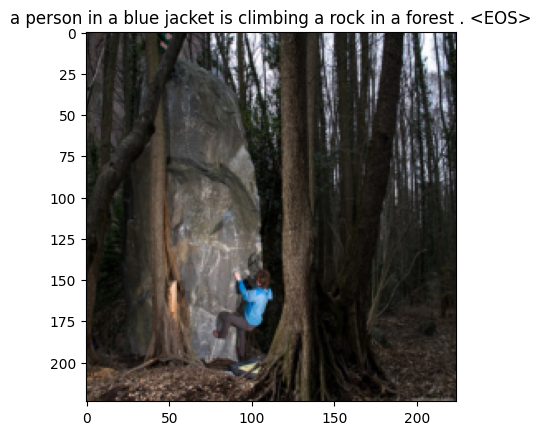

Epoch: 39 loss: 0.80719
caption:  a young girl is pointing at the water on the beach . <EOS>
# Original Caption: a young girl is standing on the shore and pointing to the ocean .
BLEU score: 0.0223


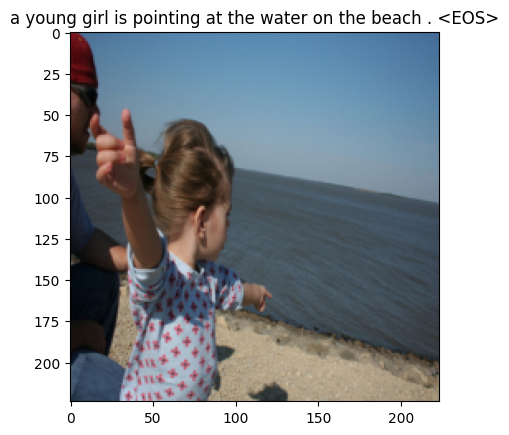

Epoch: 40 loss: 0.82386
caption:  a group of people waiting in line for a game . <EOS>
# Original Caption: a group of people waiting in line for a game .
BLEU score: 0.0238


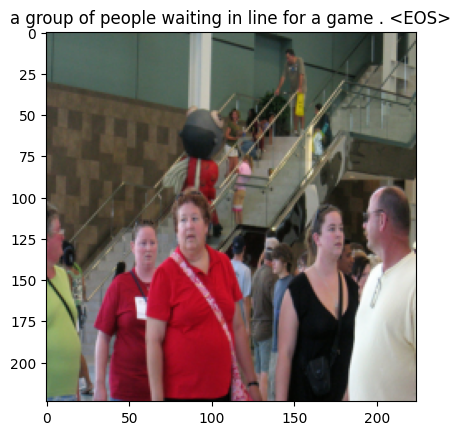

Epoch: 41 loss: 0.77820
caption:  a cyclist rides his bike over a stone wall . <EOS>
# Original Caption: a cyclist rides his black bicycle while wearing a yellow jacket and white helmet .
BLEU score: 0.0257


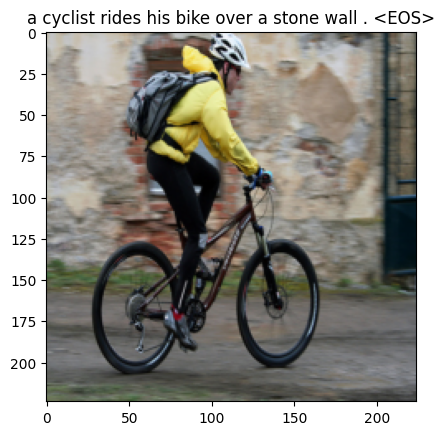

Epoch: 42 loss: 0.71193
caption:  a brown and white dog is sniffing the snow covered ground . <EOS>
# Original Caption: a lean white and brown dog makes its way through a patch of snow .
BLEU score: 0.0223


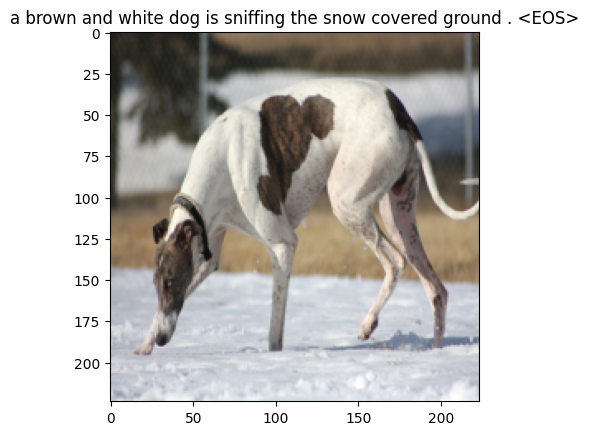

Epoch: 43 loss: 0.68217
caption:  three dogs walking on the waters edge of the shore . <EOS>
# Original Caption: three large dogs are playing in the water at the beach .
BLEU score: 0.0200


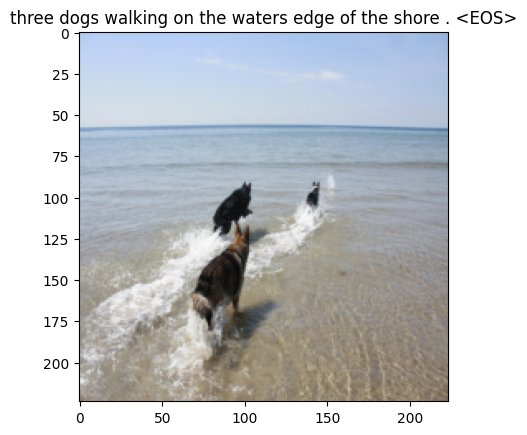

Epoch: 44 loss: 0.76310
caption:  the man in the straw hat smokes a cigarette . <EOS>
# Original Caption: a man wearing a straw hat smokes a cigarette .
BLEU score: 0.0257


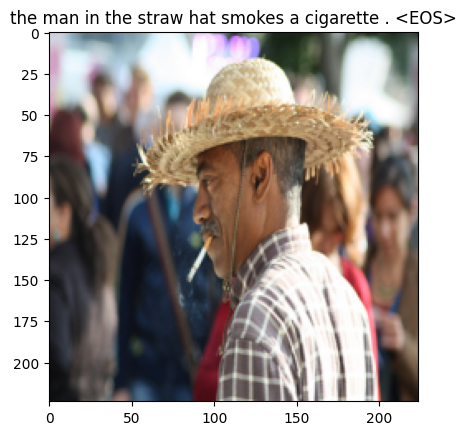

Epoch: 45 loss: 0.73882
caption:  a dog is galloping on a dirt path in front of a tree . <EOS>
# Original Caption: a dog pants while standing in the woods .
BLEU score: 0.0197


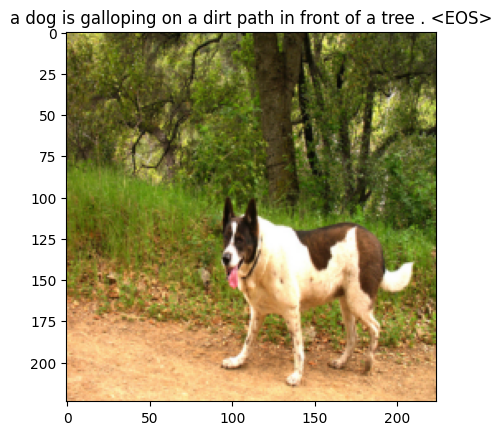

Epoch: 46 loss: 0.70061
caption:  a pug stands on the bank of a pond while a larger dog stands in the water . <EOS>
# Original Caption: a tan dog watching a brown dog swimming in a pond .
BLEU score: 0.0162


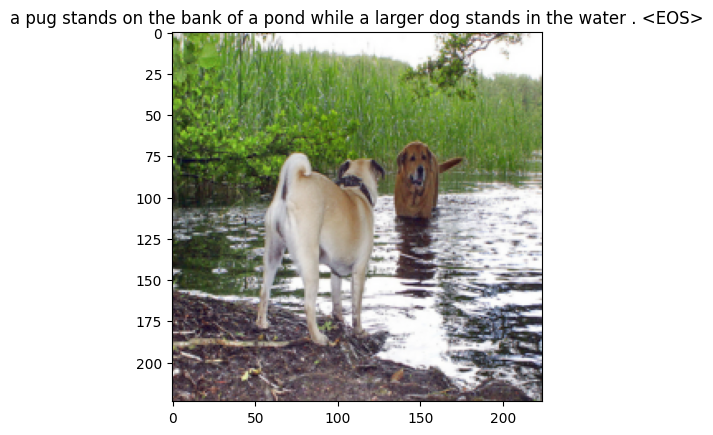

Epoch: 47 loss: 0.66966
caption:  a group of children play <UNK> and a man in a white shirt watches . <EOS>
# Original Caption: a group of young children performing song and playing instruments .
BLEU score: 0.0187


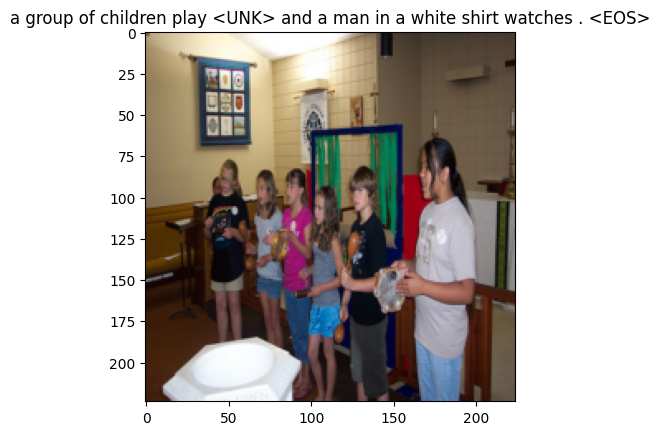

Epoch: 48 loss: 0.65356
caption:  a big brown dog looks at a small black dog in a grassy field . <EOS>
# Original Caption: a dog looks <UNK> at the brown dog <UNK> his area .
BLEU score: 0.0207


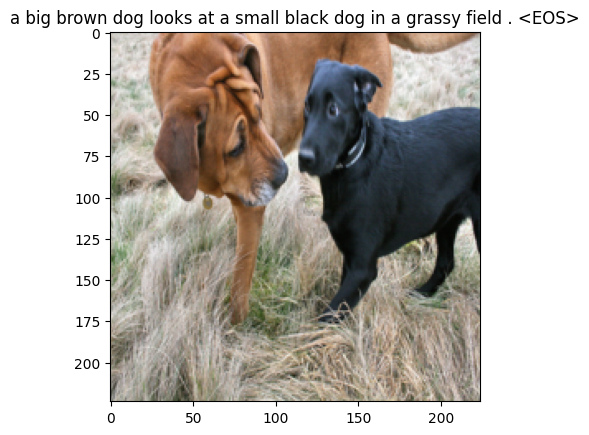

Epoch: 49 loss: 0.69831
caption:  two boys play in the sand <EOS>
# Original Caption: two young boys sitting in water and digging in the sand .
BLEU score: 0.0000


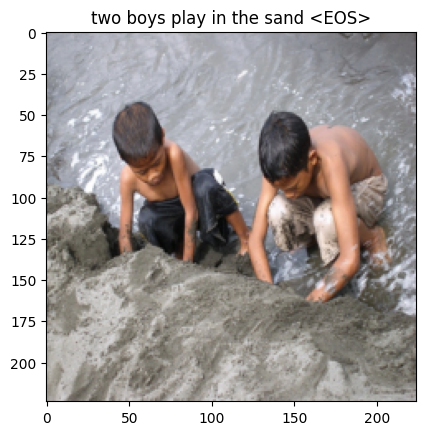

Epoch: 50 loss: 0.66631
caption:  a little girl in a colorful dress playing with a blue and red soccer ball . <EOS>
# Original Caption: a little girl in a colorful dress is playing with a blue and red soccer ball .
BLEU score: 0.0178


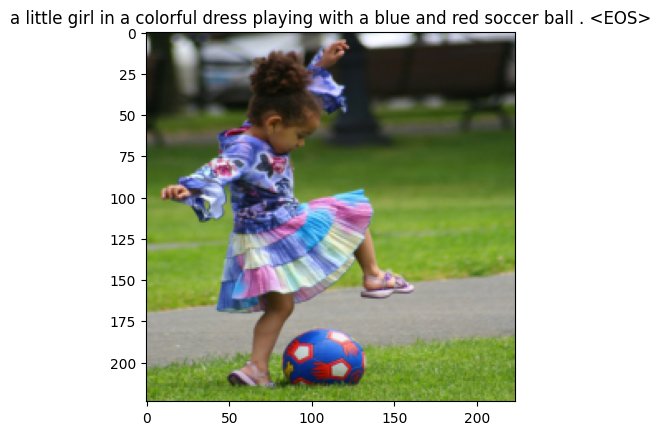

In [23]:
# full v3
# batch size 64
# dataset 35000
# data_loader 547

num_epochs = 50
print_every = 300
losses = []
loss_each_epoch = []

for epoch in range(1,num_epochs+1):   
    for idx, (image, captions) in enumerate(iter(data_loader)):
        image, captions = image.to(device),captions.to(device)

        # Zero the gradients.
        optimizer.zero_grad()

        # Feed forward
        outputs,attentions = model(image, captions)

        # Calculate the batch loss.
        targets = captions[:,1:]
        loss = criterion(outputs.view(-1, vocab_size), targets.reshape(-1))
        
        # Backward pass.
        loss.backward()
        losses.append(loss.item())

        # Update the parameters in the optimizer.
        optimizer.step()

        if (idx + 1)%print_every == 0:
            print("Epoch: {} loss: {:.5f}".format(epoch,loss.item()))
            loss_each_epoch.append(loss.item())
            references = []
            hypotheses = []
            
            #generate the caption
            model.eval()
            with torch.no_grad():
                dataiter = iter(data_loader)
                img, cap = next(dataiter) # (64, 3, 224, 224)
                features = model.encoder(img[0:1].to(device))
                caps,alphas = model.decoder.generate_caption(features,vocab=dataset.vocab)
                caption = ' '.join(caps)
                print("caption: ", caption)

                reference = [dataset.vocab.itos[token] for token in cap.tolist()[0]]
                i = 0
                while i < len(reference):
                    if reference[i] == '<PAD>':
                        del reference[i]
                    else:
                        i += 1
                references.append(reference)
                hypotheses.append(caps)
                
                caption_label = [dataset.vocab.itos[token] for token in cap[0].tolist()]
                eos_index = caption_label.index('<EOS>')
                caption_label = caption_label[1:eos_index]
                caption_label = ' '.join(caption_label)   
                print("# Original Caption:",caption_label)

                bleu_score = nltk.translate.bleu_score.corpus_bleu(references, hypotheses, smoothing_function=smoothie)
                print("BLEU score: {:.4f}".format(bleu_score))

                show_image(img[0],title=caption)

            
            model.train()
        
    #save the latest model
    save_model(model,epoch)

### 3000 image v2

Epoch: 1 loss: 3.49016


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


caption:  a man in a red shirt is standing on a <UNK> . <EOS>
# Original Caption: a girl in a red shirt is standing around with her yellow bag and black purse at her side .
BLEU score: 0.0223


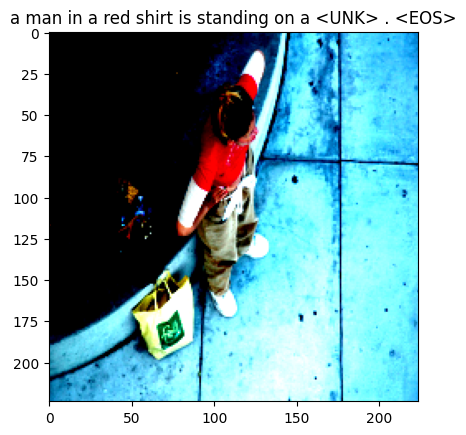

Epoch: 2 loss: 2.76846


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


caption:  a dog is running through the snow . <EOS>
# Original Caption: large <UNK> <UNK> dog wearing red collar <UNK> through the snow .
BLEU score: 0.0306


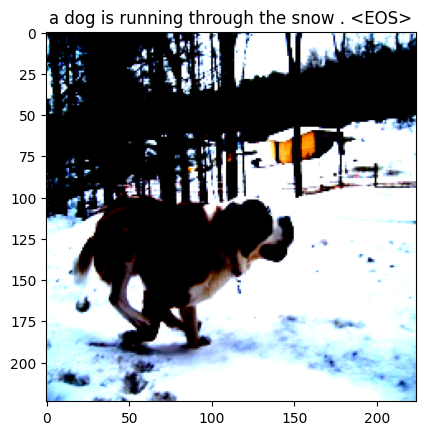

Epoch: 3 loss: 2.89242


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


caption:  a man in a red shirt is sitting on a <UNK> . <EOS>
# Original Caption: a group of people sit watching an event behind a <UNK> <UNK> sign .
BLEU score: 0.0223


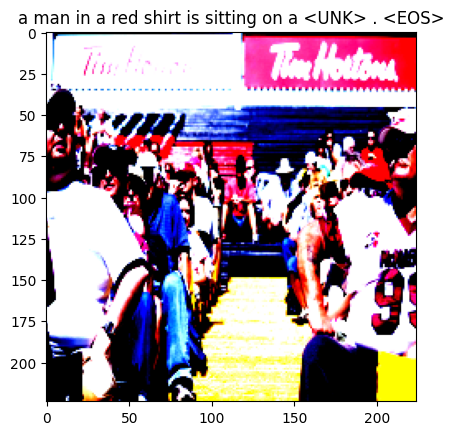

Epoch: 4 loss: 2.55859


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


caption:  a brown dog is running in the snow . <EOS>
# Original Caption: a dog in the snow .
BLEU score: 0.0279


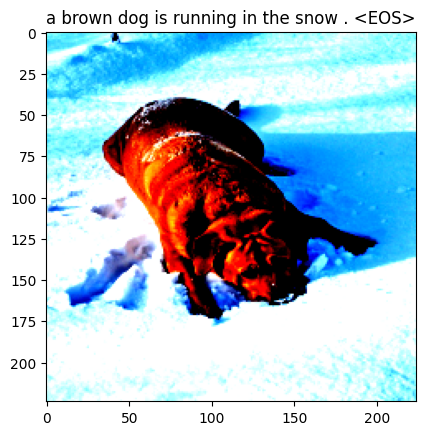

Epoch: 5 loss: 2.58928


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


caption:  a man and a dog running in a field . <EOS>
# Original Caption: three grey dogs jump at a woman .
BLEU score: 0.0257


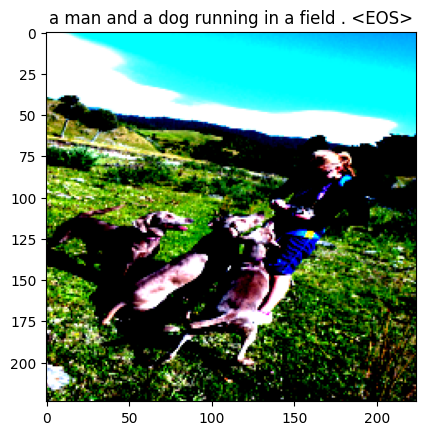

Epoch: 6 loss: 2.25941


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


caption:  a man is climbing a rock . <EOS>
# Original Caption: a large rock formation in the middle of a forest .
BLEU score: 0.0300


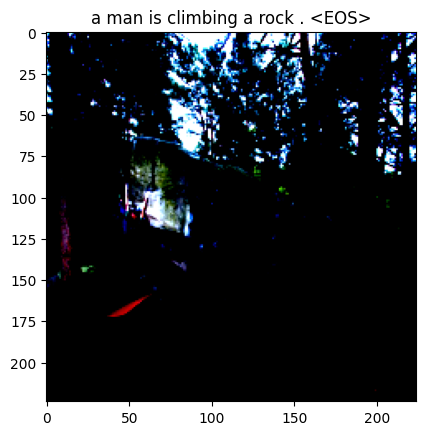

Epoch: 7 loss: 2.23317


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


caption:  a young boy in a soccer ball in a field . <EOS>
# Original Caption: two soccer ball players are chasing after the ball .
BLEU score: 0.0238


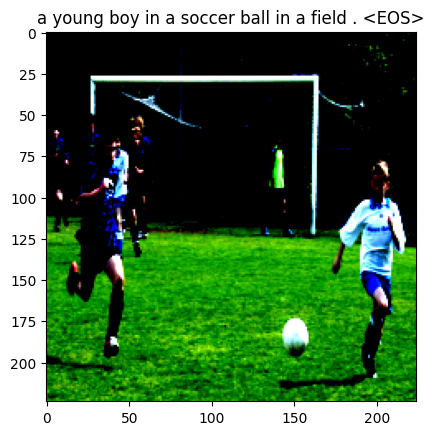

Epoch: 8 loss: 2.22032


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


caption:  a girl in a pink dress is standing in front of a <UNK> wall . <EOS>
# Original Caption: a young girl climbs a rock wall , in a purple dress .
BLEU score: 0.0187


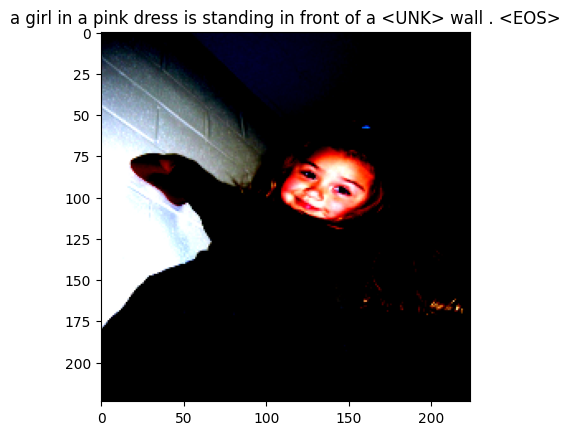

Epoch: 9 loss: 2.10233


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


caption:  a dog running in the sand . <EOS>
# Original Caption: a dog running through the sand .
BLEU score: 0.0340


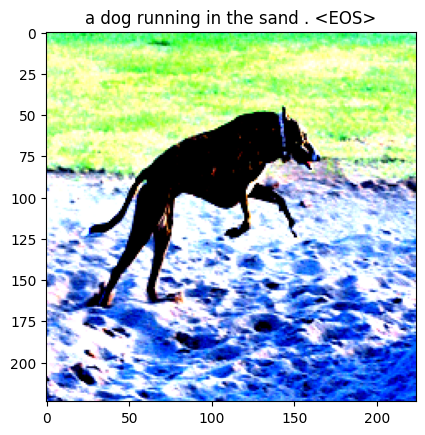

Epoch: 10 loss: 1.92407


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


caption:  a small dog is sniffing a cow . <EOS>
# Original Caption: a small grey dog is in the grass with a brown cow .
BLEU score: 0.0306


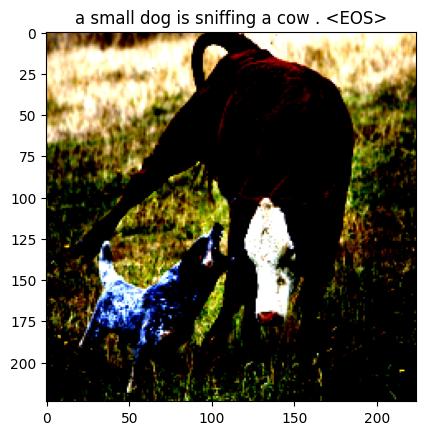

Epoch: 11 loss: 1.66119


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


caption:  three children play basketball . <EOS>
# Original Caption: three small boys play basketball indoors .
BLEU score: 0.0376


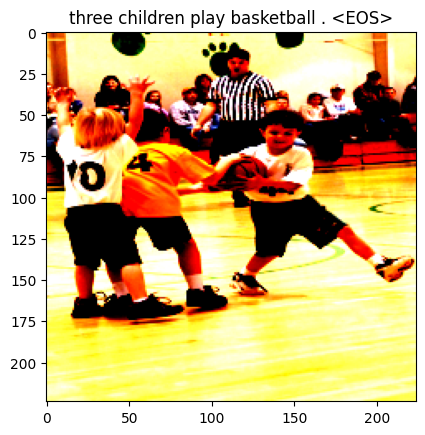

Epoch: 12 loss: 1.77054


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


caption:  two men are <UNK> on a <UNK> . <EOS>
# Original Caption: two men are sleeping on <UNK> <UNK> on the side of a cliff .
BLEU score: 0.0306


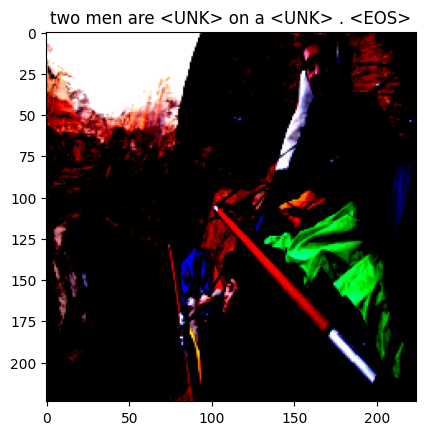

Epoch: 13 loss: 1.54462


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


caption:  two brown and white dogs are fighting . <EOS>
# Original Caption: two blurry dogs .
BLEU score: 0.0257


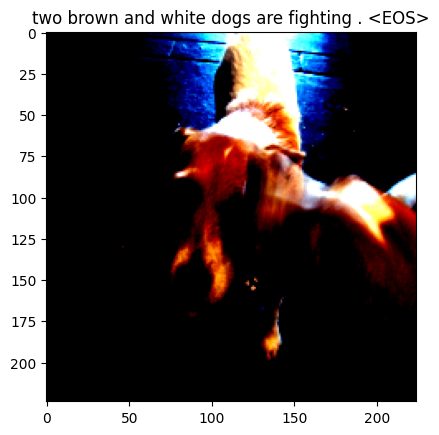

Epoch: 14 loss: 1.61899


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


caption:  a woman in a pink hoodie takes a picture . <EOS>
# Original Caption: a girl wearing a pink hoodie looks through her camera .
BLEU score: 0.0284


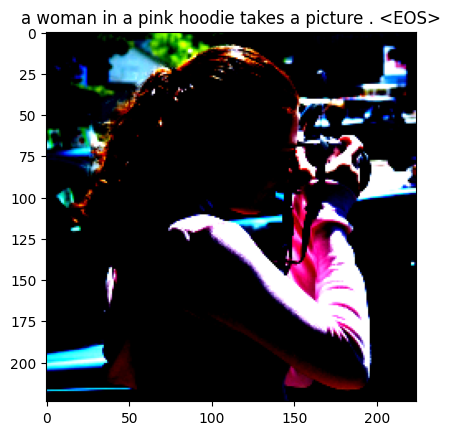

Epoch: 15 loss: 1.54729


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


caption:  a brown horse is walking on a sandy beach . <EOS>
# Original Caption: a large brown horse stands over a small black <UNK> that is kneeling on the sand .
BLEU score: 0.0257


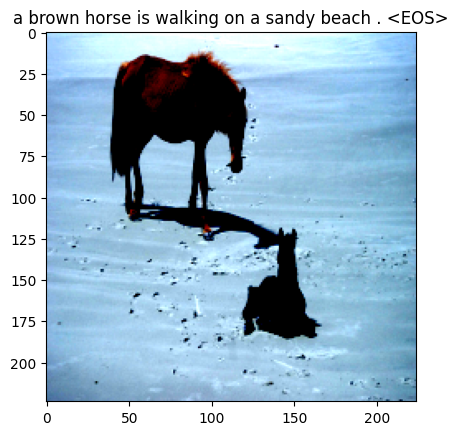

Epoch: 16 loss: 1.41890


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


caption:  a man holds a ball into a net while a boy <UNK> him . <EOS>
# Original Caption: the man is holding the net for the boy playing baseball .
BLEU score: 0.0218


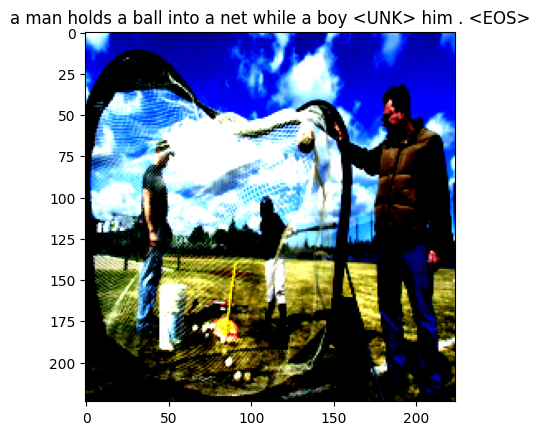

Epoch: 17 loss: 1.45387


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


caption:  a dog is <UNK> on the grass . <EOS>
# Original Caption: a medium sized brown dog jumping
BLEU score: 0.0257


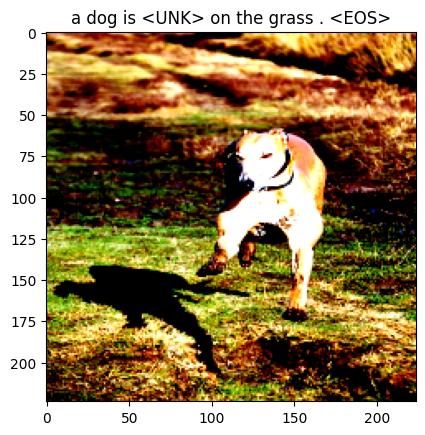

Epoch: 18 loss: 1.29585


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


caption:  a brown and white dog jumping on a sandy beach <EOS>
# Original Caption: a brown and white dog jumping on a sandy beach
BLEU score: 0.0216


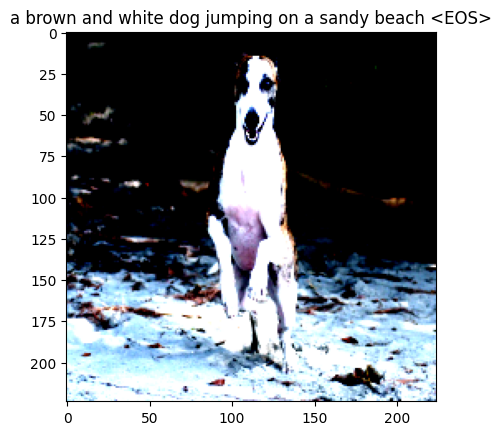

Epoch: 19 loss: 1.35841


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


caption:  a man lays on a bench with a dog sitting on a bench . <EOS>
# Original Caption: man laying on bench holding leash of dog sitting on ground
BLEU score: 0.0166


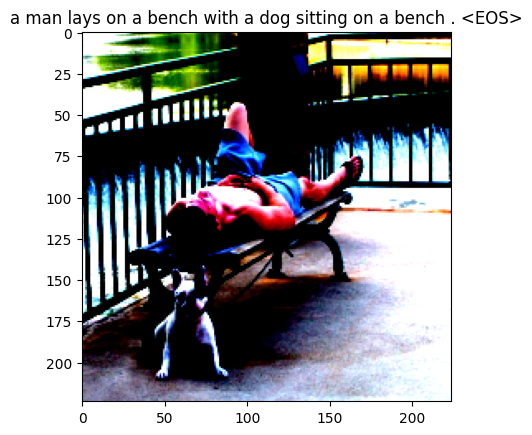

Epoch: 20 loss: 1.44453


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


caption:  a person on a rock formation . <EOS>
# Original Caption: a boy stands on a rocky mountain .
BLEU score: 0.0340


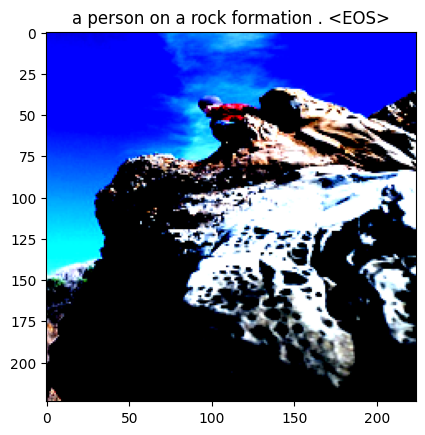

Epoch: 21 loss: 1.19813


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


caption:  two small dogs playing in the snow . <EOS>
# Original Caption: two small dogs playing in the snow together .
BLEU score: 0.0257


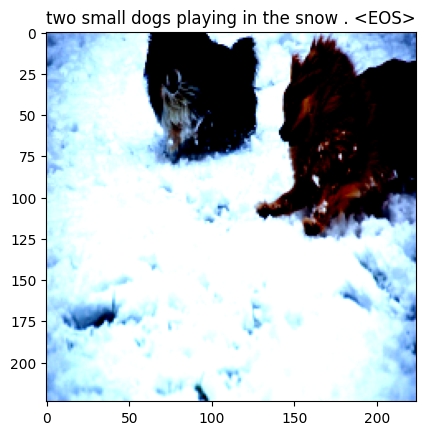

Epoch: 22 loss: 1.17448


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


caption:  three children play on a hay . <EOS>
# Original Caption: three children playing with hay outdoors , throwing some at camera <UNK> .
BLEU score: 0.0340


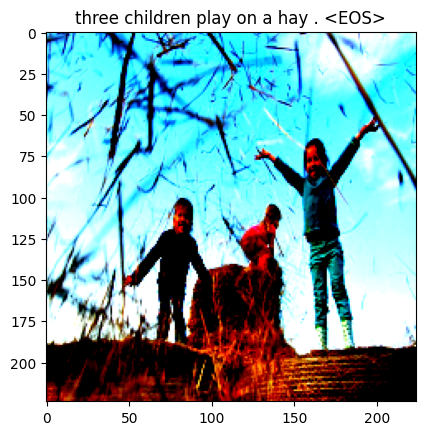

Epoch: 23 loss: 1.13674


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


caption:  the white dog is carrying a ball in its mouth . <EOS>
# Original Caption: the dog is holding a ball in his mouth .
BLEU score: 0.0238


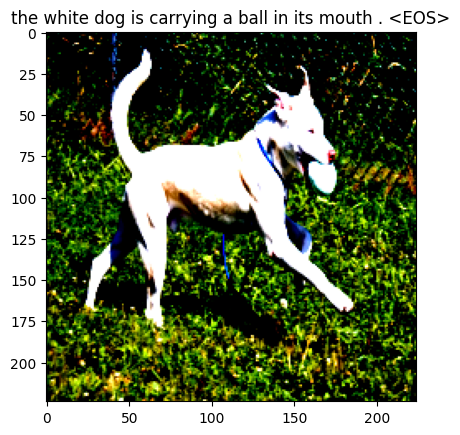

Epoch: 24 loss: 1.12702


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


caption:  kids are playing in water fountains <EOS>
# Original Caption: children in swimming suits playing in water .
BLEU score: 0.0000


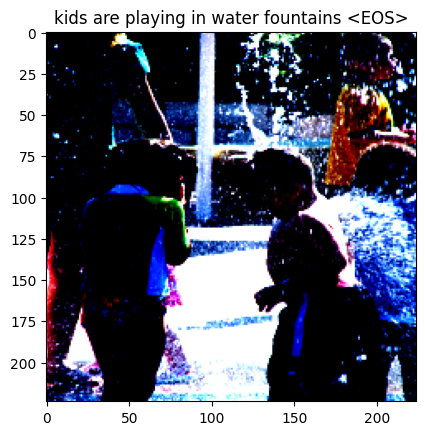

Epoch: 25 loss: 1.15559


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


caption:  a <UNK> vehicle is carried by a <UNK> truck in a night - time scene . <EOS>
# Original Caption: a flat bed truck in a parking lot with an <UNK> vehicle on its bed .
BLEU score: 0.0178


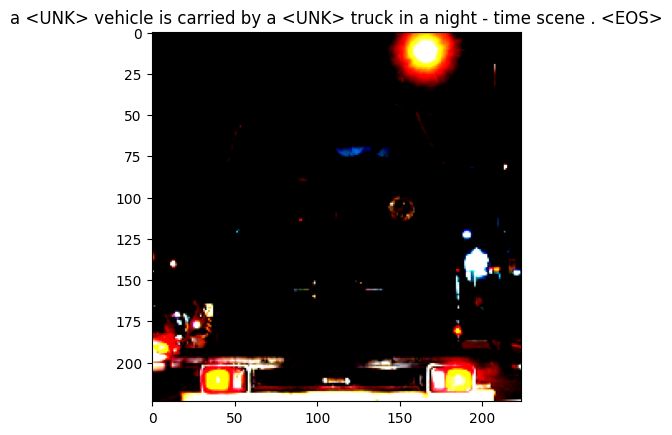

In [51]:
# 3000 image v2
# batch size 64
# dataset 15000
# data_loader 235

num_epochs = 25
print_every = 200
losses = []

for epoch in range(1,num_epochs+1):   
    for idx, (image, captions) in enumerate(iter(data_loader)):
        image, captions = image.to(device),captions.to(device)

        # Zero the gradients.
        optimizer.zero_grad()

        # Feed forward
        outputs,attentions = model(image, captions)

        # Calculate the batch loss.
        targets = captions[:,1:]
        loss = criterion(outputs.view(-1, vocab_size), targets.reshape(-1))
        
        # Backward pass.
        loss.backward()
        losses.append(loss.item())

        # Update the parameters in the optimizer.
        optimizer.step()

        if (idx + 1)%print_every == 0:
            print("Epoch: {} loss: {:.5f}".format(epoch,loss.item()))
            references = []
            hypotheses = []
            
            #generate the caption
            model.eval()
            with torch.no_grad():
                dataiter = iter(data_loader)
                img, cap = next(dataiter) # (64, 3, 224, 224)
                features = model.encoder(img[0:1].to(device))
                caps,alphas = model.decoder.generate_caption(features,vocab=dataset.vocab)
                caption = ' '.join(caps)
                print("caption: ", caption)

                reference = [dataset.vocab.itos[token] for token in cap.tolist()[0]]
                i = 0
                while i < len(reference):
                    if reference[i] == '<PAD>':
                        del reference[i]
                    else:
                        i += 1
                references.append(reference)
                hypotheses.append(caps)
                
                caption_label = [dataset.vocab.itos[token] for token in cap[0].tolist()]
                eos_index = caption_label.index('<EOS>')
                caption_label = caption_label[1:eos_index]
                caption_label = ' '.join(caption_label)   
                print("# Original Caption:",caption_label)

                bleu_score = nltk.translate.bleu_score.corpus_bleu(references, hypotheses, smoothing_function=smoothie)
                print("BLEU score: {:.4f}".format(bleu_score))

                show_image(img[0],title=caption)

            
            model.train()
        
    #save the latest model
    save_model(model,epoch)

### 3000 image

Epoch: 1 loss: 3.70174
caption:  a black dog is running through the water . <EOS>
# Original Caption: a large black dog is playing in the ocean .
BLEU score: 0.0279


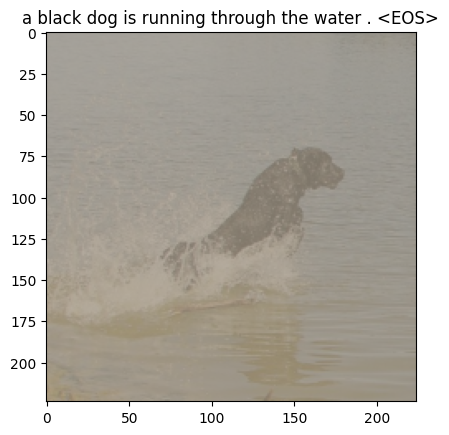

Epoch: 2 loss: 2.94590
caption:  a white dog is running through the grass . <EOS>
# Original Caption: a fluffy white dog is outside .
BLEU score: 0.0279


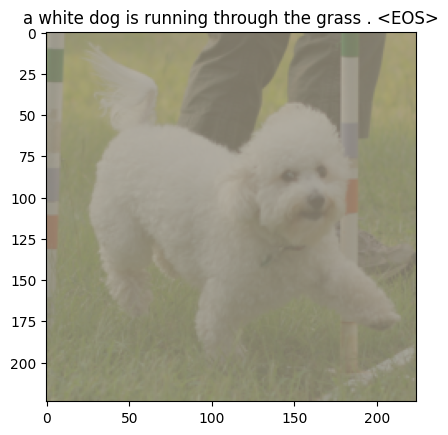

Epoch: 3 loss: 2.75236
caption:  a man in a red shirt and a woman in a blue shirt and a woman in a blue shirt
# Original Caption: these people are walking away from the camera , while one person carries another .
BLEU score: 0.0155


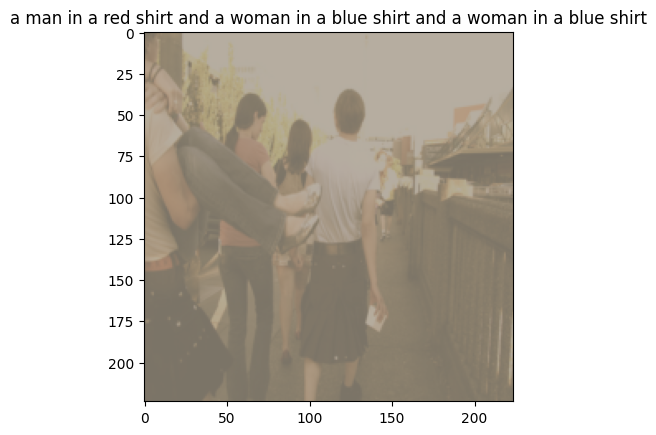

Epoch: 4 loss: 2.63673
caption:  two dogs are playing with a white dog . <EOS>
# Original Caption: two dogs fight over a piece of cloth .
BLEU score: 0.0279


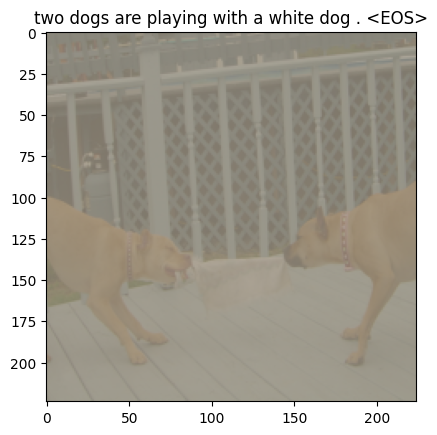

Epoch: 5 loss: 2.43402
caption:  two girls in <UNK> <UNK> <UNK> . <EOS>
# Original Caption: two little girls <UNK> in a karate <UNK> .
BLEU score: 0.0286


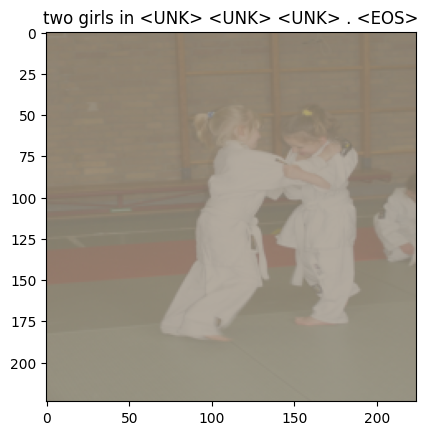

Epoch: 6 loss: 2.48349
caption:  a woman in a pink shirt is holding a picture . <EOS>
# Original Caption: a woman takes a picture during the day .
BLEU score: 0.0238


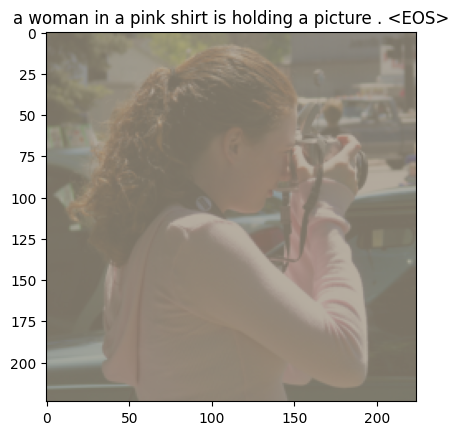

Epoch: 7 loss: 2.36790
caption:  a man stands on a cliff overlooking the ocean . <EOS>
# Original Caption: a man stands on the edge of a cliff <UNK> the ocean .
BLEU score: 0.0257


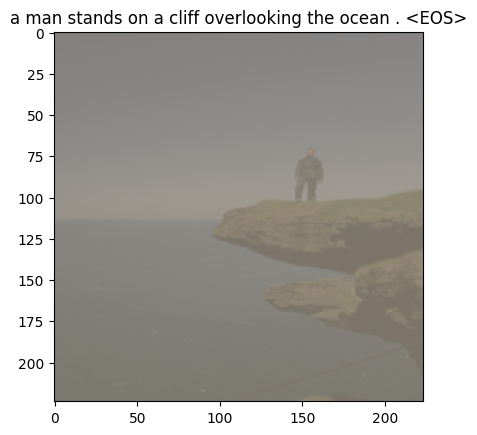

Epoch: 8 loss: 1.90815
caption:  a girl in a red shirt is sitting on a slide . <EOS>
# Original Caption: a little girl and a little boy playing on a <UNK> ride .
BLEU score: 0.0223


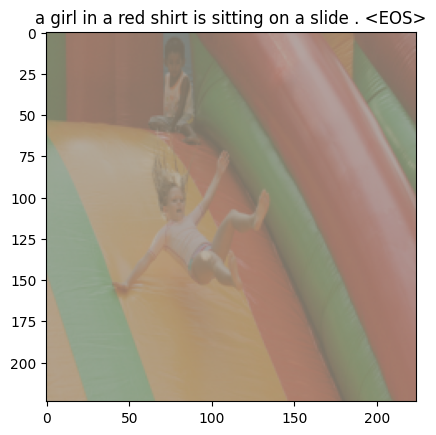

Epoch: 9 loss: 1.95114
caption:  a child is <UNK> by a colorful balls . <EOS>
# Original Caption: little girl lying in many colored plastic balls .
BLEU score: 0.0279


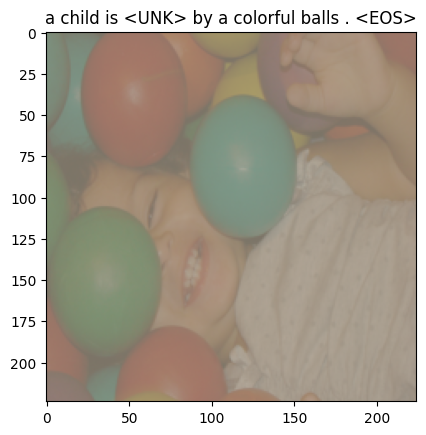

Epoch: 10 loss: 2.04345
caption:  a man in a blue shirt and a white shirt is holding a picture . <EOS>
# Original Caption: a crowd of people look at something out of frame , one man takes a picture .
BLEU score: 0.0187


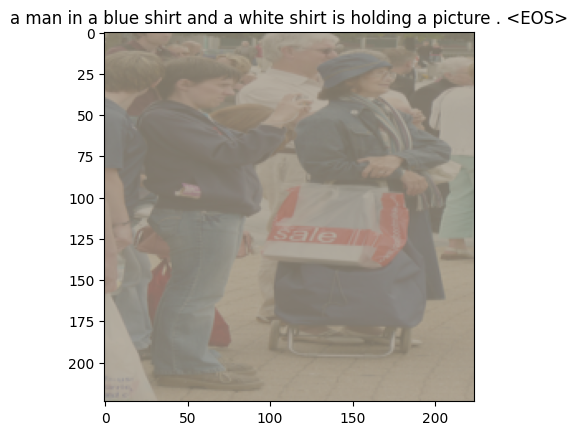

Epoch: 11 loss: 1.84614
caption:  a dog jumps over a hurdle . <EOS>
# Original Caption: a collie jumps over a hurdle .
BLEU score: 0.0340


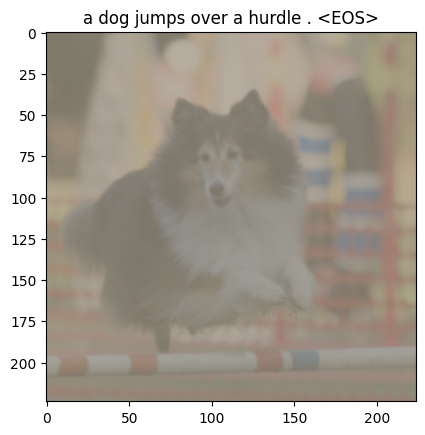

Epoch: 12 loss: 1.71340
caption:  a football player in the red and white jersey is running in the field . <EOS>
# Original Caption: two men play football .
BLEU score: 0.0187


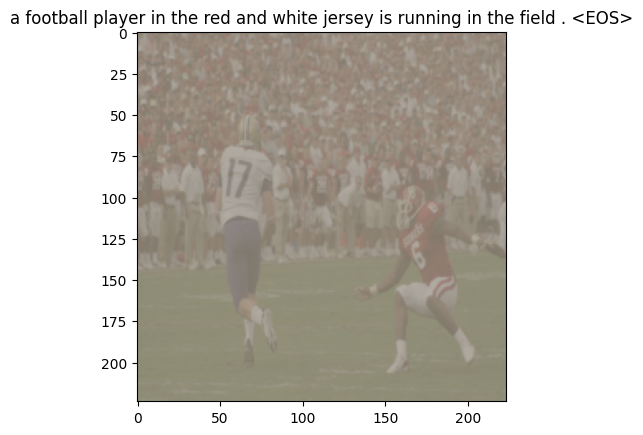

Epoch: 13 loss: 1.66531
caption:  a dog jumps in the air to catch a ball . <EOS>
# Original Caption: the dog is in the air above the grass .
BLEU score: 0.0238


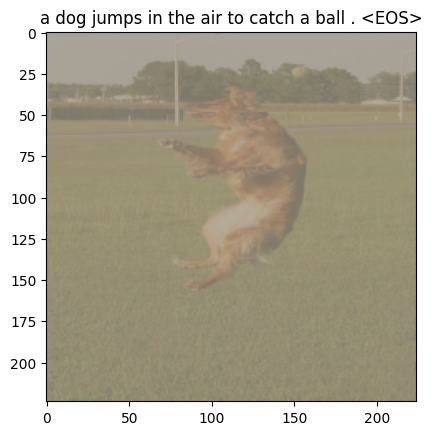

Epoch: 14 loss: 1.42021
caption:  a little boy in a swimming pool is being <UNK> by water . <EOS>
# Original Caption: a boy in an inflatable pool is being splashed with water .
BLEU score: 0.0231


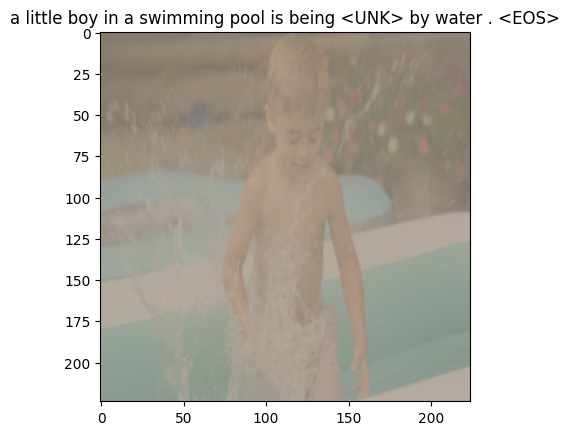

Epoch: 15 loss: 1.59195
caption:  a young man wearing a yellow shirt and baseball <UNK> a baseball bat <EOS>
# Original Caption: a young boy is getting ready to hit a baseball .
BLEU score: 0.0209


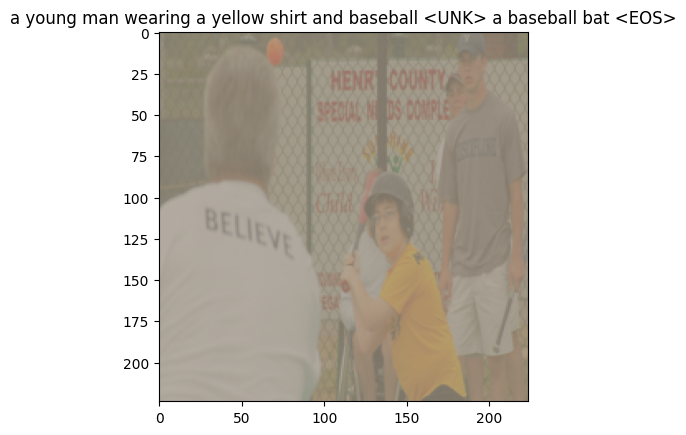

Epoch: 16 loss: 1.56881
caption:  two boys are squirting water at each other . <EOS>
# Original Caption: two children wearing jeans squirt water at each other .
BLEU score: 0.0235


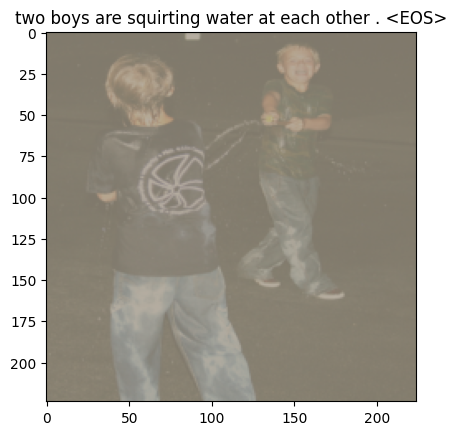

Epoch: 17 loss: 1.39314
caption:  a dog swims through the water . <EOS>
# Original Caption: a dog swims through the water while holding a stick in its mouth .
BLEU score: 0.0340


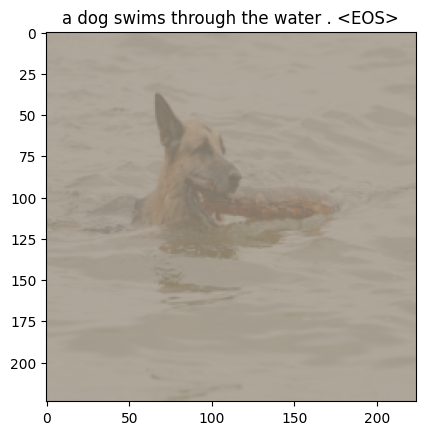

Epoch: 18 loss: 1.37634
caption:  a man with a backpack is walking on a grassy path carrying a backpack . <EOS>
# Original Caption: a man is carrying <UNK> <UNK> <UNK> a plain .
BLEU score: 0.0187


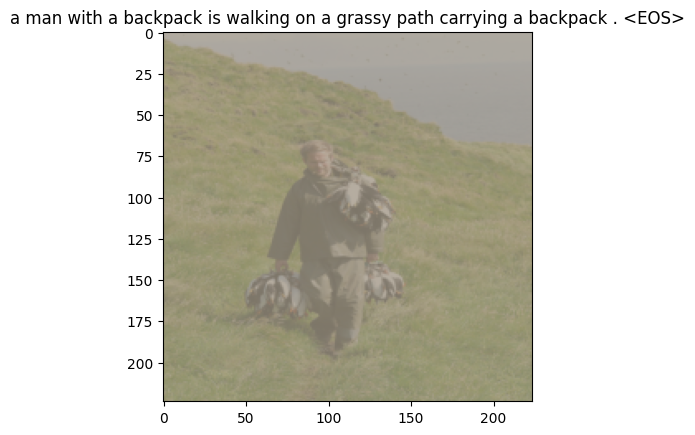

Epoch: 19 loss: 1.19247
caption:  a man and a woman are sitting on a <UNK> <EOS>
# Original Caption: the man and woman are hugging and kissing near <UNK> performing .
BLEU score: 0.0216


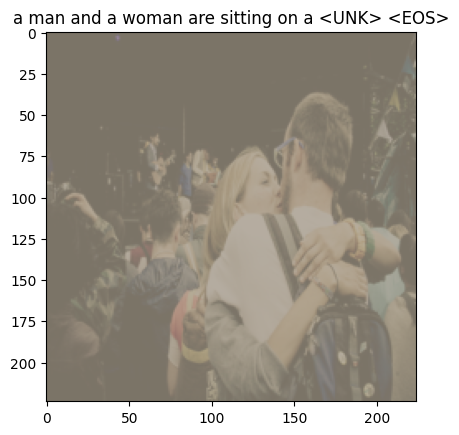

Epoch: 20 loss: 1.13669
caption:  a little girl holds a yellow water hose and water is drinking from the water . <EOS>
# Original Caption: a young girl holds a running water hose , from which a brown dog next to her is drinking .
BLEU score: 0.0178


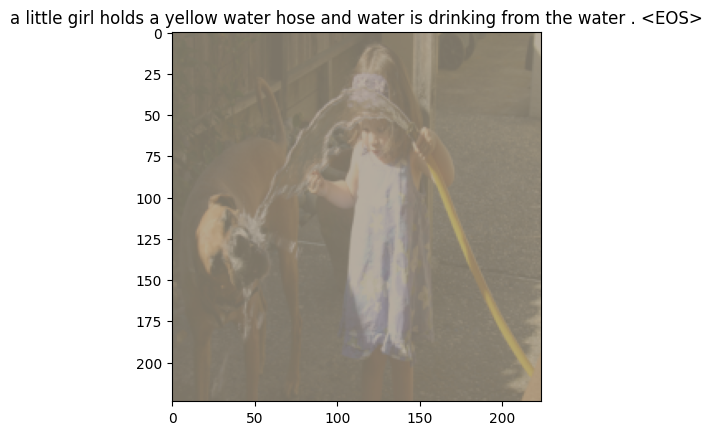

Epoch: 21 loss: 1.26273
caption:  a girl in a blue dress is standing in a crowd . <EOS>
# Original Caption: the back of a lady wearing a blue <UNK> top is shown , a crowd in the distance .
BLEU score: 0.0223


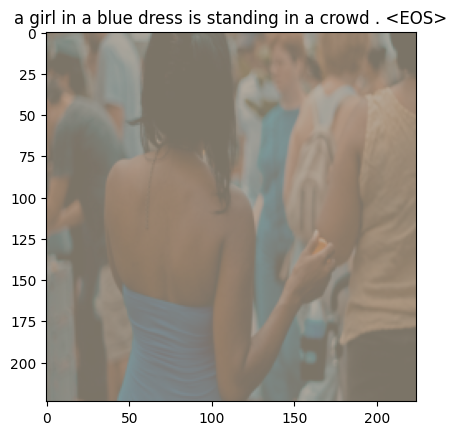

Epoch: 22 loss: 1.08393
caption:  a football player runs with the ball . <EOS>
# Original Caption: a man runs with the football at a <UNK> or <UNK> game .
BLEU score: 0.0306


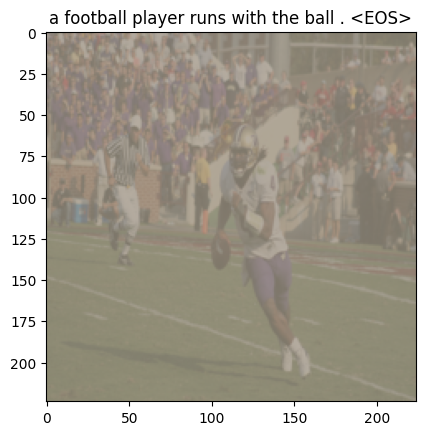

Epoch: 23 loss: 1.15236
caption:  a child in a red jacket runs through a pile of hay . <EOS>
# Original Caption: a child in a bright red jacket runs through a pile of hay .
BLEU score: 0.0209


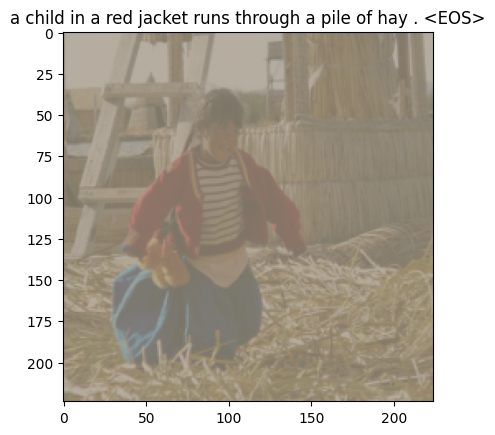

Epoch: 24 loss: 1.06988
caption:  a girl wearing a white coat stands in the middle of sprinklers . <EOS>
# Original Caption: a girl wearing a white coat standing in a fountain .
BLEU score: 0.0209


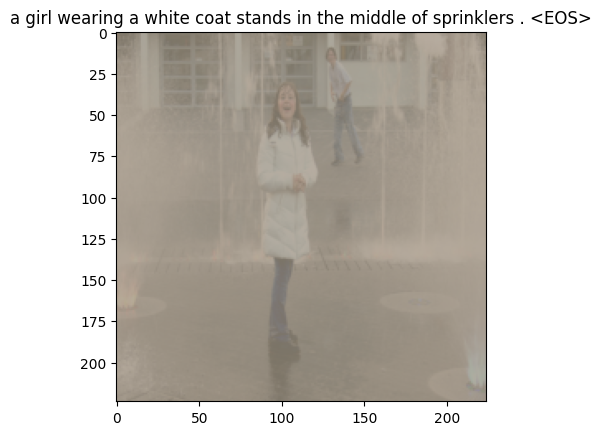

Epoch: 25 loss: 1.10707
caption:  a man sits by a dock looking at the water . <EOS>
# Original Caption: a lone man wearing sunglasses sitting on a concrete wall
BLEU score: 0.0200


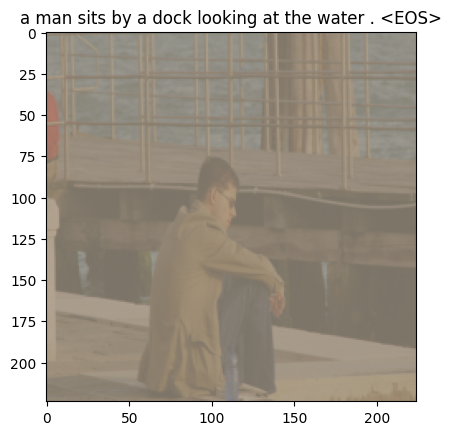

In [25]:
# 3000
# batch size 64
# dataset 15000
# data_loader 235

num_epochs = 25
print_every = 200
losses = []

for epoch in range(1,num_epochs+1):   
    for idx, (image, captions) in enumerate(iter(data_loader)):
        image, captions = image.to(device),captions.to(device)

        # Zero the gradients.
        optimizer.zero_grad()

        # Feed forward
        outputs,attentions = model(image, captions)

        # Calculate the batch loss.
        targets = captions[:,1:]
        loss = criterion(outputs.view(-1, vocab_size), targets.reshape(-1))
        
        # Backward pass.
        loss.backward()
        losses.append(loss.item())

        # Update the parameters in the optimizer.
        optimizer.step()

        if (idx + 1)%print_every == 0:
            print("Epoch: {} loss: {:.5f}".format(epoch,loss.item()))
            references = []
            hypotheses = []
            
            #generate the caption
            model.eval()
            with torch.no_grad():
                dataiter = iter(data_loader)
                img, cap = next(dataiter) # (64, 3, 224, 224)
                features = model.encoder(img[0:1].to(device))
                caps,alphas = model.decoder.generate_caption(features,vocab=dataset.vocab)
                caption = ' '.join(caps)
                print("caption: ", caption)

                reference = [dataset.vocab.itos[token] for token in cap.tolist()[0]]
                i = 0
                while i < len(reference):
                    if reference[i] == '<PAD>':
                        del reference[i]
                    else:
                        i += 1
                references.append(reference)
                hypotheses.append(caps)
                
                caption_label = [dataset.vocab.itos[token] for token in cap[0].tolist()]
                eos_index = caption_label.index('<EOS>')
                caption_label = caption_label[1:eos_index]
                caption_label = ' '.join(caption_label)   
                print("# Original Caption:",caption_label)

                bleu_score = nltk.translate.bleu_score.corpus_bleu(references, hypotheses, smoothing_function=smoothie)
                print("BLEU score: {:.4f}".format(bleu_score))

                show_image(img[0],title=caption)

            
            model.train()
        
    #save the latest model
    save_model(model,epoch)

### 7000 image v2

Epoch: 1 loss: 3.51380
caption:  a man in a red shirt is jumping on a <UNK> . <EOS>
# Original Caption: a man is crouching down holding on to his large brown dog .
BLEU score: 0.0223


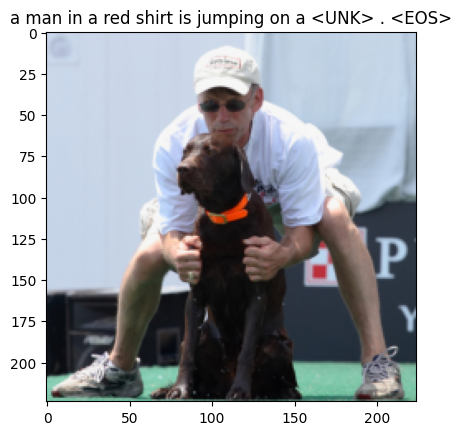

Epoch: 2 loss: 3.11052
caption:  a man in a black shirt is sitting on a <UNK> of a <UNK> . <EOS>
# Original Caption: the man in the blue shirt wearing headphones around his neck is sitting next to the man who is working at a computer .
BLEU score: 0.0187


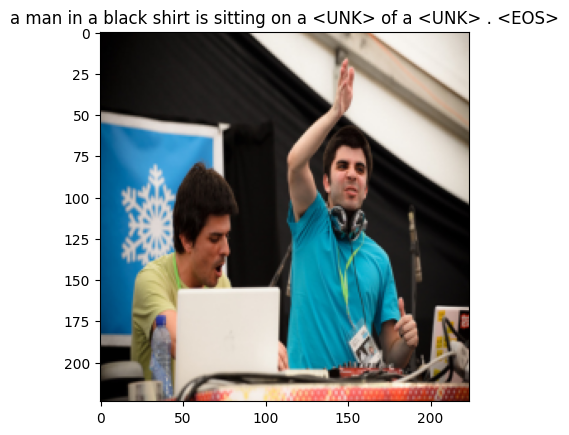

Epoch: 3 loss: 2.76117
caption:  a man in a <UNK> <UNK> at a table . <EOS>
# Original Caption: a group of people gathered around in the dark .
BLEU score: 0.0257


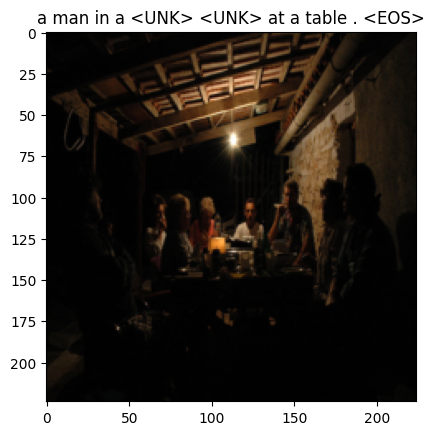

Epoch: 4 loss: 2.52585
caption:  a football player in a red uniform is running on the field . <EOS>
# Original Caption: two football player are in the kick off position in front of a crowd .
BLEU score: 0.0209


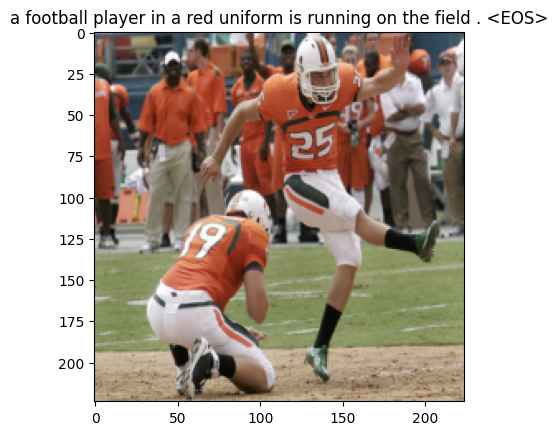

Epoch: 5 loss: 2.59960
caption:  a girl in a blue shirt is playing soccer . <EOS>
# Original Caption: a young girl is kicking a soccer ball in the grass .
BLEU score: 0.0257


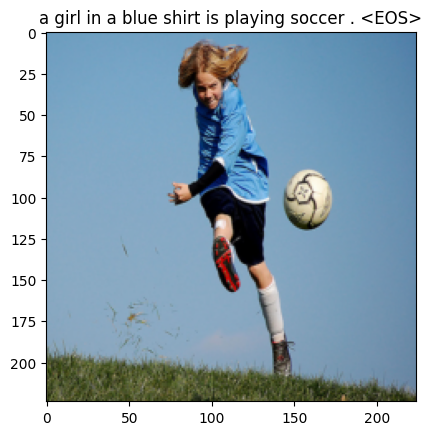

Epoch: 6 loss: 2.19512
caption:  two men are standing on a beach with a <UNK> in the background . <EOS>
# Original Caption: a group of people are standing on a beach near to a white <UNK> .
BLEU score: 0.0197


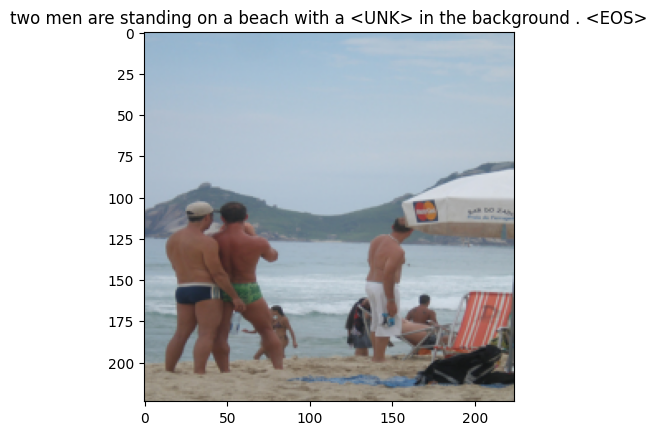

Epoch: 7 loss: 2.14400
caption:  a tennis player in a white shirt is playing tennis . <EOS>
# Original Caption: a tennis player about to hit the ball .
BLEU score: 0.0238


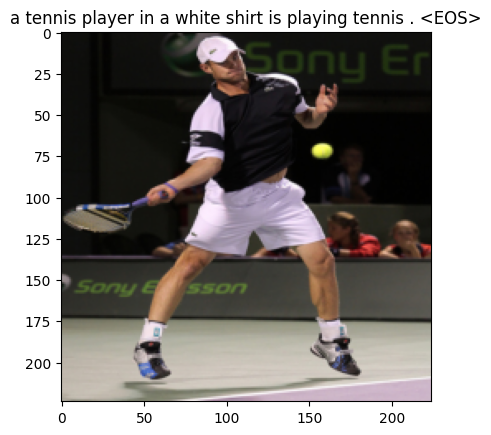

Epoch: 8 loss: 2.04870
caption:  a black and white dog is jumping over a tennis ball . <EOS>
# Original Caption: a white and black dog is jumping in the air trying to catch a tennis ball .
BLEU score: 0.0223


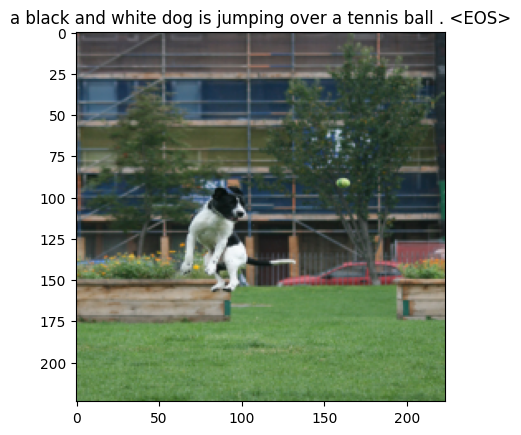

Epoch: 9 loss: 1.92612
caption:  a child is sitting on a couch . <EOS>
# Original Caption: woman sitting on a red couch inside the house .
BLEU score: 0.0306


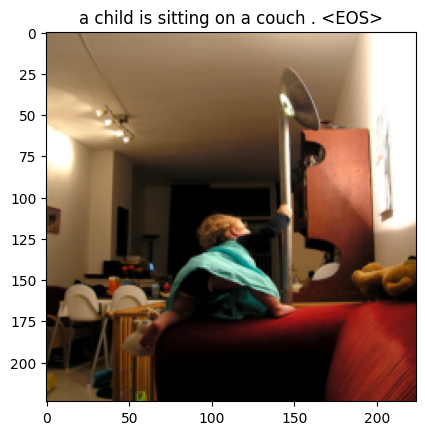

Epoch: 10 loss: 1.81103
caption:  a horse is being thrown by a horse . <EOS>
# Original Caption: a cowboy gets kicked off a horse that is bucking
BLEU score: 0.0235


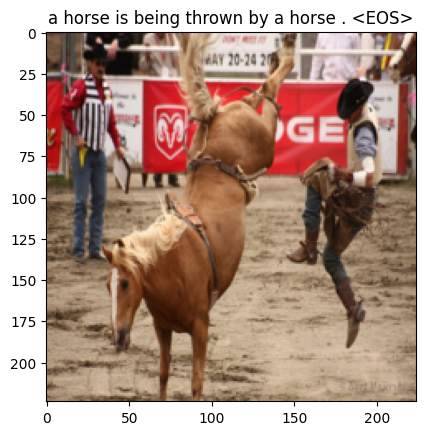

Epoch: 11 loss: 1.86210
caption:  a skateboarder in a green shirt is jumping in the air . <EOS>
# Original Caption: a boy is airborne on his skateboard above a set of rails in an industrial setting .
BLEU score: 0.0246


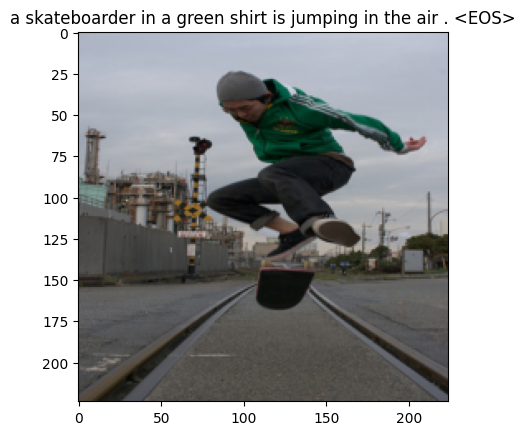

Epoch: 12 loss: 1.91113
caption:  a <UNK> in a <UNK> costume is being <UNK> by a woman . <EOS>
# Original Caption: costumed woman <UNK> lipstick .
BLEU score: 0.0209


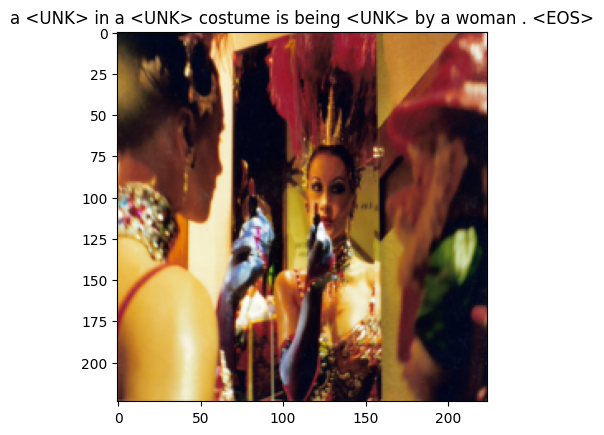

Epoch: 13 loss: 1.76140
caption:  a catcher of a baseball player in a white uniform and a baseball player in a white uniform is running
# Original Caption: catcher on the ground , runner making base .
BLEU score: 0.0130


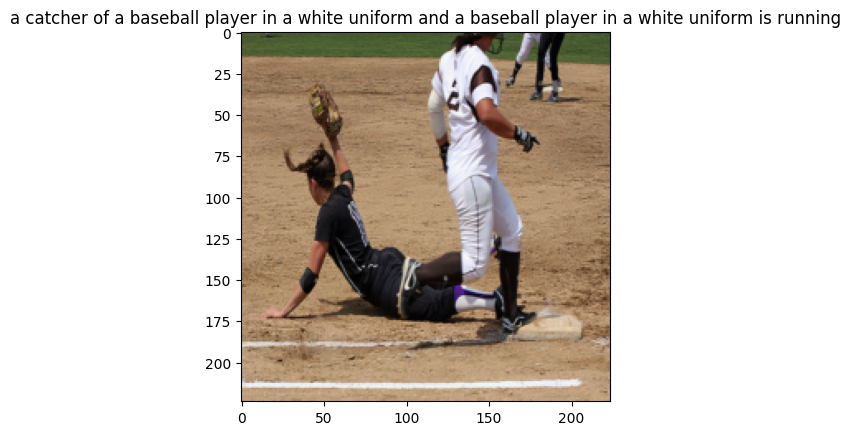

Epoch: 14 loss: 1.76198
caption:  one girl in a blue shirt is standing in front of a woman in a blue shirt . <EOS>
# Original Caption: one girl is taking a picture of another girl outside .
BLEU score: 0.0162


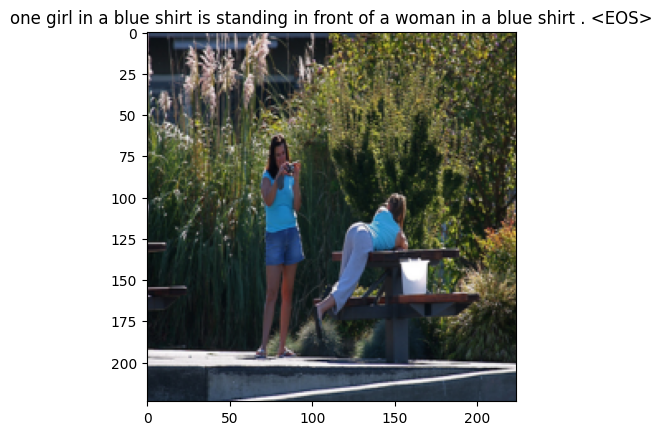

Epoch: 15 loss: 1.70559
caption:  two black dogs are running in a field . <EOS>
# Original Caption: a black dog is running in a field of grass and another black dog can be seen behind him .
BLEU score: 0.0279


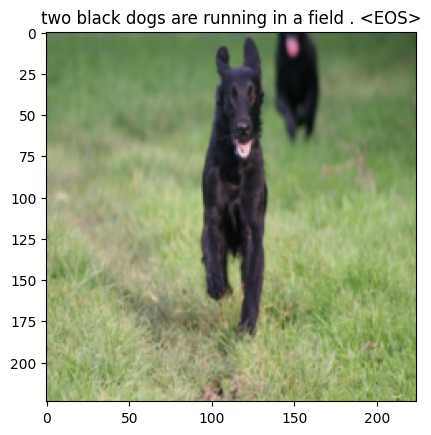

Epoch: 16 loss: 1.52788
caption:  three dogs running through a grassy field . <EOS>
# Original Caption: three dogs moving through grass .
BLEU score: 0.0306


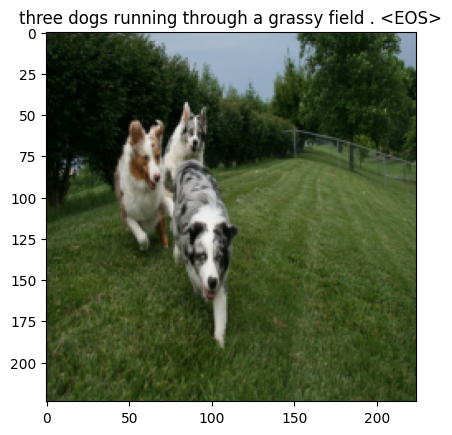

Epoch: 17 loss: 1.54168
caption:  a dog swimming in a lake . <EOS>
# Original Caption: three ducks and a dog swim in a lake .
BLEU score: 0.0340


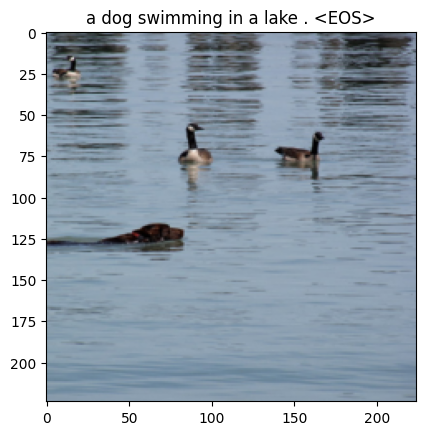

Epoch: 18 loss: 1.43479
caption:  two people hang into a large rock . <EOS>
# Original Caption: two people <UNK> down into a hole .
BLEU score: 0.0306


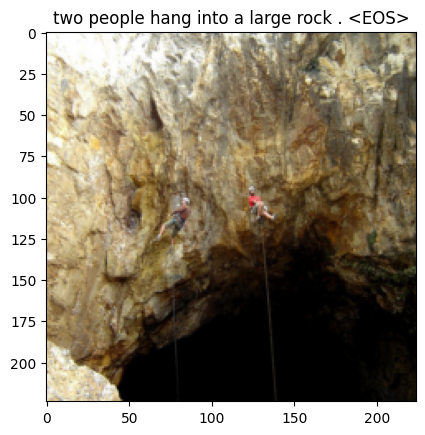

Epoch: 19 loss: 1.37258
caption:  a young girl is blowing on a dandelion . <EOS>
# Original Caption: a blond gear with a pink shirt is blowing on a dandelion .
BLEU score: 0.0279


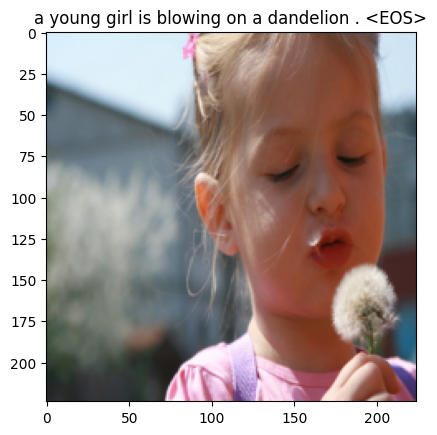

Epoch: 20 loss: 1.30459
caption:  a man in a blue headband plays tennis . <EOS>
# Original Caption: this man , wearing a blue headband and white shirt , is playing tennis .
BLEU score: 0.0309


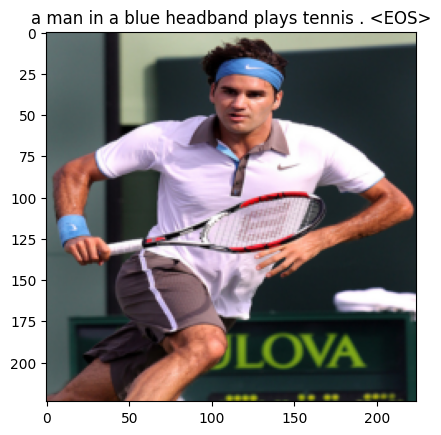

Epoch: 21 loss: 1.35067
caption:  a young boy in swim trunks and a blue bathing suit running in a race . <EOS>
# Original Caption: a wet boy carrying goggles runs .
BLEU score: 0.0178


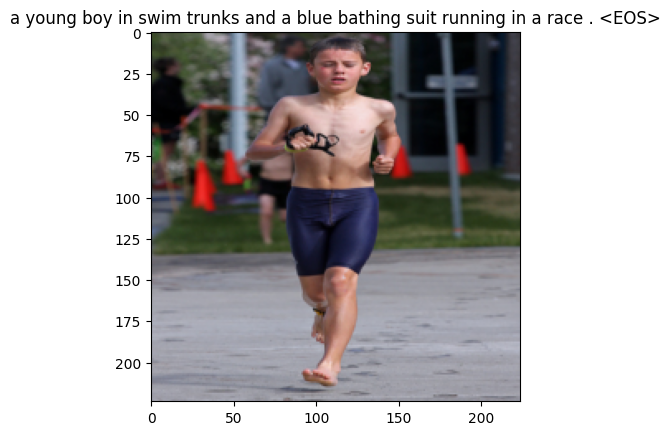

Epoch: 22 loss: 1.22718
caption:  three dogs are playing in a grassy field . <EOS>
# Original Caption: three dogs play in a grassy field .
BLEU score: 0.0279


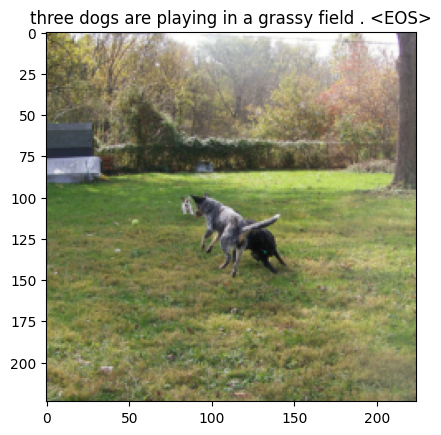

Epoch: 23 loss: 1.21194
caption:  a small dog catches a tennis ball in its mouth . <EOS>
# Original Caption: a dog catches a tennis ball .
BLEU score: 0.0238


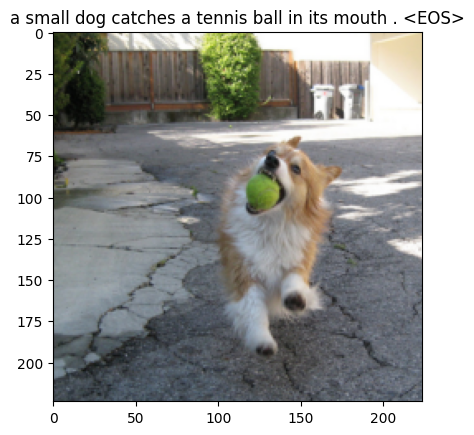

Epoch: 24 loss: 1.09505
caption:  a skateboarder does a trick on his skateboard . <EOS>
# Original Caption: a young man does a trick on his skateboard on a slope .
BLEU score: 0.0309


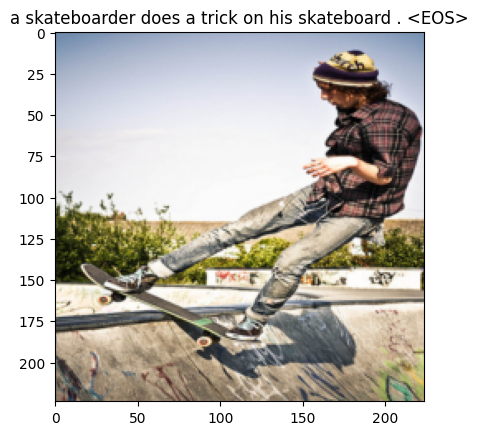

Epoch: 25 loss: 1.21418
caption:  a boy plays baseball . <EOS>
# Original Caption: a boy plays baseball .
BLEU score: 0.0447


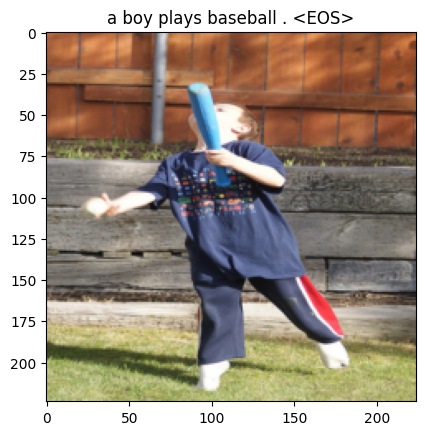

In [24]:
# full v2
# batch size 64
# dataset 35000
# data_loader 547

num_epochs = 25
print_every = 300
losses = []
loss_each_epoch = []

for epoch in range(1,num_epochs+1):   
    for idx, (image, captions) in enumerate(iter(data_loader)):
        image, captions = image.to(device),captions.to(device)

        # Zero the gradients.
        optimizer.zero_grad()

        # Feed forward
        outputs,attentions = model(image, captions)

        # Calculate the batch loss.
        targets = captions[:,1:]
        loss = criterion(outputs.view(-1, vocab_size), targets.reshape(-1))
        
        # Backward pass.
        loss.backward()
        losses.append(loss.item())

        # Update the parameters in the optimizer.
        optimizer.step()

        if (idx + 1)%print_every == 0:
            print("Epoch: {} loss: {:.5f}".format(epoch,loss.item()))
            loss_each_epoch.append(loss.item())
            references = []
            hypotheses = []
            
            #generate the caption
            model.eval()
            with torch.no_grad():
                dataiter = iter(data_loader)
                img, cap = next(dataiter) # (64, 3, 224, 224)
                features = model.encoder(img[0:1].to(device))
                caps,alphas = model.decoder.generate_caption(features,vocab=dataset.vocab)
                caption = ' '.join(caps)
                print("caption: ", caption)

                reference = [dataset.vocab.itos[token] for token in cap.tolist()[0]]
                i = 0
                while i < len(reference):
                    if reference[i] == '<PAD>':
                        del reference[i]
                    else:
                        i += 1
                references.append(reference)
                hypotheses.append(caps)
                
                caption_label = [dataset.vocab.itos[token] for token in cap[0].tolist()]
                eos_index = caption_label.index('<EOS>')
                caption_label = caption_label[1:eos_index]
                caption_label = ' '.join(caption_label)   
                print("# Original Caption:",caption_label)

                bleu_score = nltk.translate.bleu_score.corpus_bleu(references, hypotheses, smoothing_function=smoothie)
                print("BLEU score: {:.4f}".format(bleu_score))

                show_image(img[0],title=caption)

            
            model.train()
        
    #save the latest model
    save_model(model,epoch)

### 7000 image

Epoch: 1 loss: 3.73308
caption:  a man in a blue shirt and a white shirt is standing in a <UNK> . <EOS>
# Original Caption: two men step off the bus together .
BLEU score: 0.0149


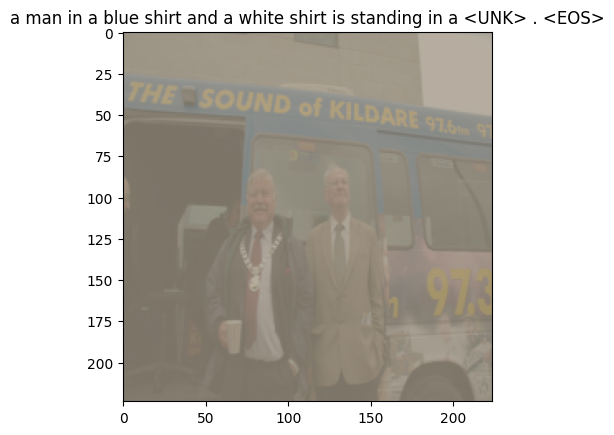

Epoch: 2 loss: 3.00694
caption:  a little girl is sitting on a <UNK> of a <UNK> . <EOS>
# Original Caption: a woman is about to put a shoe on the bride .
BLEU score: 0.0223


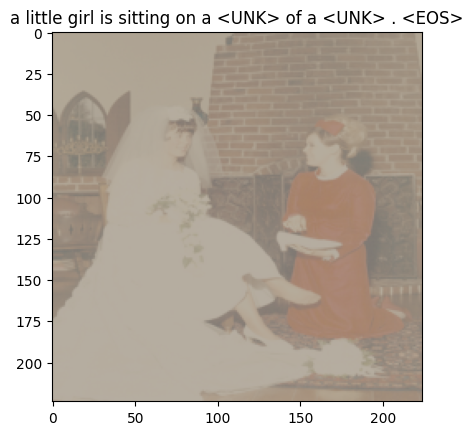

Epoch: 3 loss: 2.76032
caption:  a person is riding a jump on a snowy hill . <EOS>
# Original Caption: a man is sliding along a green barrier on his snowboard .
BLEU score: 0.0238


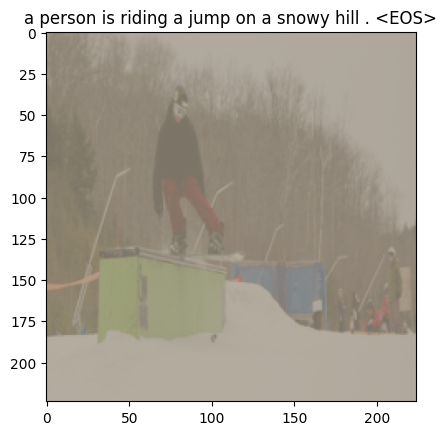

Epoch: 4 loss: 2.24396
caption:  a basketball player in a white uniform is playing basketball . <EOS>
# Original Caption: two men in uniforms playing basketball , struggle for the ball .
BLEU score: 0.0264


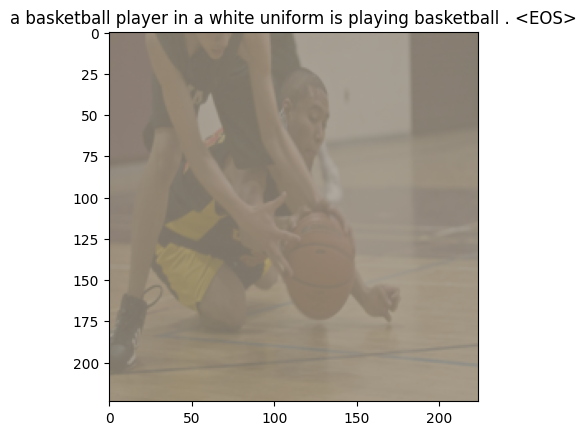

Epoch: 5 loss: 2.34349
caption:  a car in a race car . <EOS>
# Original Caption: a silver car being driven in a parking lot , while crowds watch .
BLEU score: 0.0340


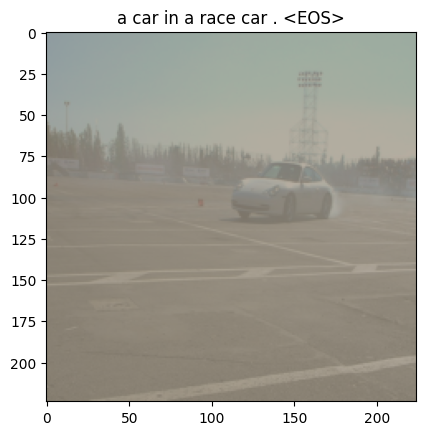

Epoch: 6 loss: 2.37078
caption:  a person is jumping off a high high in the air . <EOS>
# Original Caption: a diver midair against an urban background .
BLEU score: 0.0246


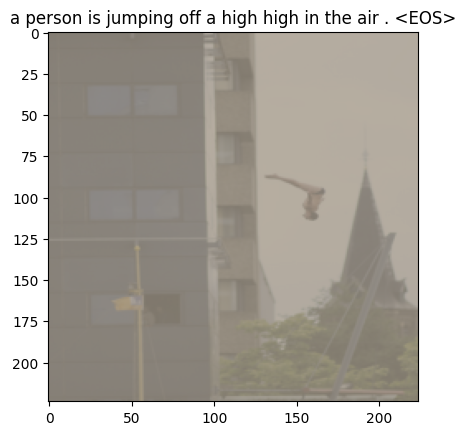

Epoch: 7 loss: 2.25968
caption:  two people are sitting on a bench with a <UNK> in front of a room . <EOS>
# Original Caption: a little boy and a little girl are lying on a black bench surrounded by adults .
BLEU score: 0.0178


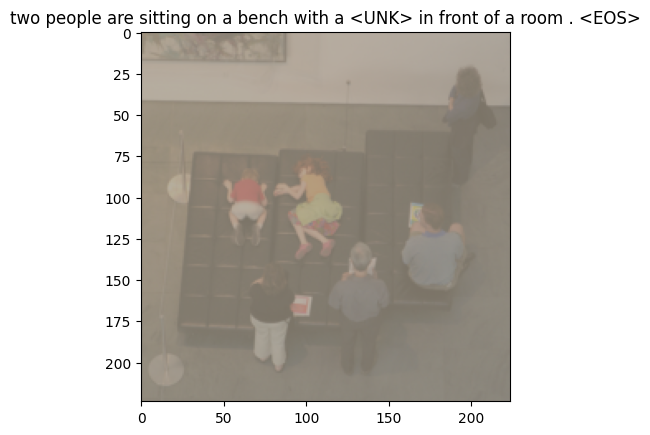

Epoch: 8 loss: 1.88133
caption:  two dogs running in a grassy field . <EOS>
# Original Caption: two <UNK> dogs in red collars are playing with a toy bird
BLEU score: 0.0257


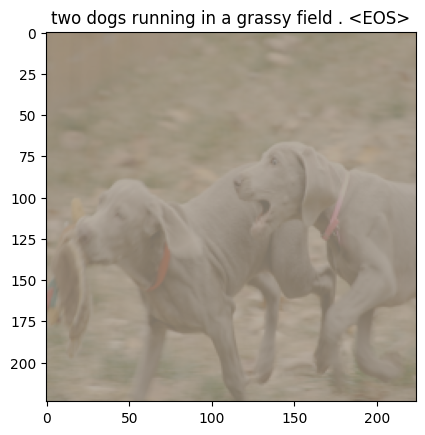

Epoch: 9 loss: 2.07884
caption:  a man and a girl playing in a fountain . <EOS>
# Original Caption: a child dressed in purple clothing and a hat runs in splashing water while a man and a small boy walk nearby .
BLEU score: 0.0257


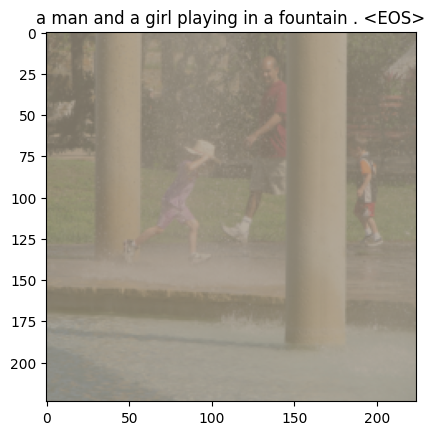

Epoch: 10 loss: 1.75694
caption:  a brown dog is running on a snowy path . <EOS>
# Original Caption: a brown dog is running on a snow covered path .
BLEU score: 0.0257


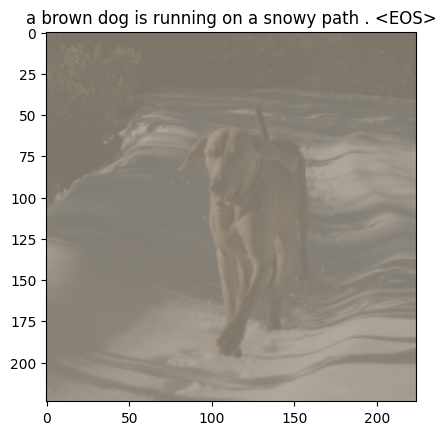

Epoch: 11 loss: 1.72702
caption:  a man with a red jacket is standing on a sidewalk in front of a <UNK> <UNK> . <EOS>
# Original Caption: two people in coats kiss on the side of a road .
BLEU score: 0.0162


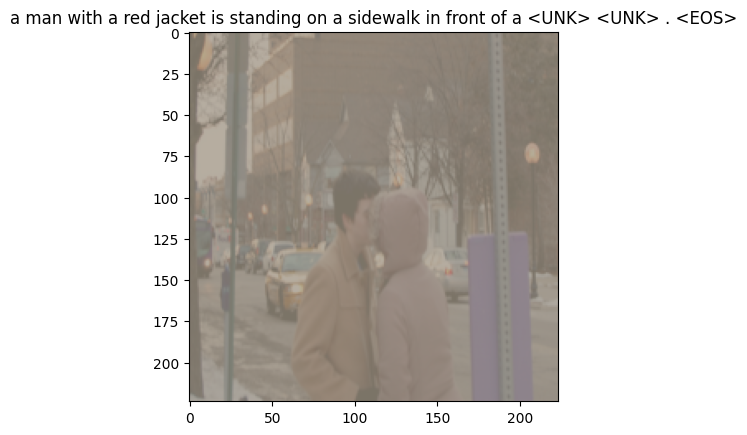

Epoch: 12 loss: 1.71138
caption:  a child in a winter coat and a hat is holding a camera . <EOS>
# Original Caption: two children stand and <UNK> to each other as another looks on .
BLEU score: 0.0197


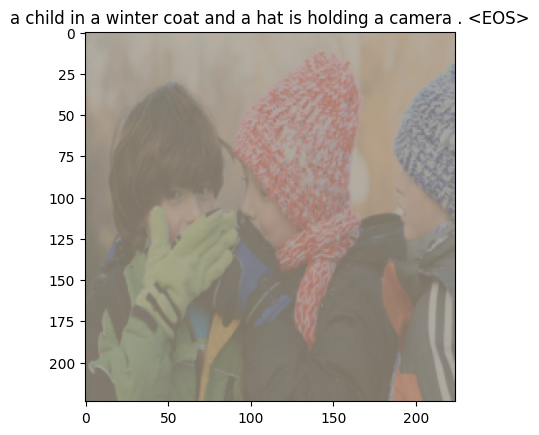

Epoch: 13 loss: 1.56143
caption:  a young boy jumping off a chair . <EOS>
# Original Caption: a boy jumping off a chair .
BLEU score: 0.0306


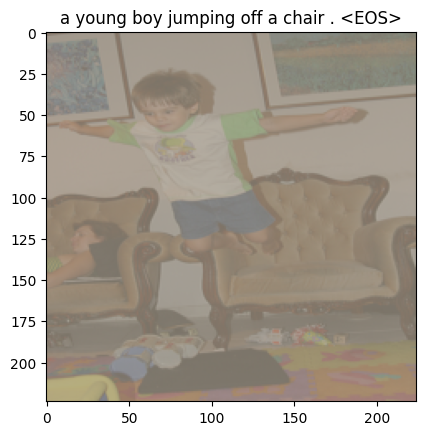

Epoch: 14 loss: 1.47420
caption:  a girl in a green shirt is standing in a field . <EOS>
# Original Caption: a dirty - blonde girl wearing a white tank top and blue jeans is standing in the middle of a green field and playing with <UNK> .
BLEU score: 0.0223


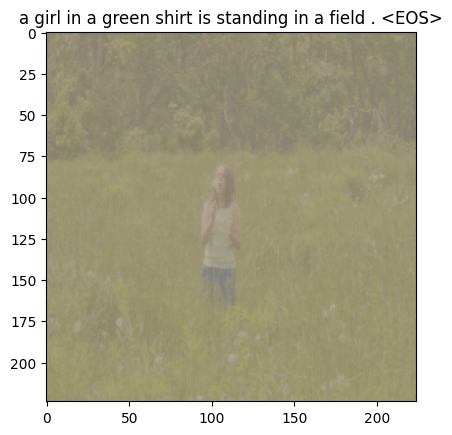

Epoch: 15 loss: 1.44362
caption:  an elderly woman in a blue jacket and sunglasses is smiling . <EOS>
# Original Caption: an elderly woman wearing a denim jacket and sunglasses is posing for a picture in front of a green bush .
BLEU score: 0.0223


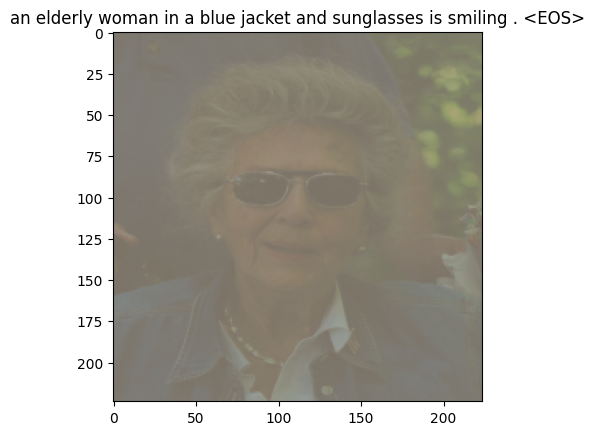

In [27]:
# full
# batch size 64
# dataset 35000
# data_loader 547

num_epochs = 15
print_every = 300
losses = []

for epoch in range(1,num_epochs+1):   
    for idx, (image, captions) in enumerate(iter(data_loader)):
        image, captions = image.to(device),captions.to(device)

        # Zero the gradients.
        optimizer.zero_grad()

        # Feed forward
        outputs,attentions = model(image, captions)

        # Calculate the batch loss.
        targets = captions[:,1:]
        loss = criterion(outputs.view(-1, vocab_size), targets.reshape(-1))
        
        # Backward pass.
        loss.backward()
        losses.append(loss.item())

        # Update the parameters in the optimizer.
        optimizer.step()

        if (idx + 1)%print_every == 0:
            print("Epoch: {} loss: {:.5f}".format(epoch,loss.item()))
            references = []
            hypotheses = []
            
            #generate the caption
            model.eval()
            with torch.no_grad():
                dataiter = iter(data_loader)
                img, cap = next(dataiter) # (64, 3, 224, 224)
                features = model.encoder(img[0:1].to(device))
                caps,alphas = model.decoder.generate_caption(features,vocab=dataset.vocab)
                caption = ' '.join(caps)
                print("caption: ", caption)

                reference = [dataset.vocab.itos[token] for token in cap.tolist()[0]]
                i = 0
                while i < len(reference):
                    if reference[i] == '<PAD>':
                        del reference[i]
                    else:
                        i += 1
                references.append(reference)
                hypotheses.append(caps)
                
                caption_label = [dataset.vocab.itos[token] for token in cap[0].tolist()]
                eos_index = caption_label.index('<EOS>')
                caption_label = caption_label[1:eos_index]
                caption_label = ' '.join(caption_label)   
                print("# Original Caption:",caption_label)

                bleu_score = nltk.translate.bleu_score.corpus_bleu(references, hypotheses, smoothing_function=smoothie)
                print("BLEU score: {:.4f}".format(bleu_score))

                show_image(img[0],title=caption)

            
            model.train()
        
    #save the latest model
    save_model(model,epoch)

## Evaluation

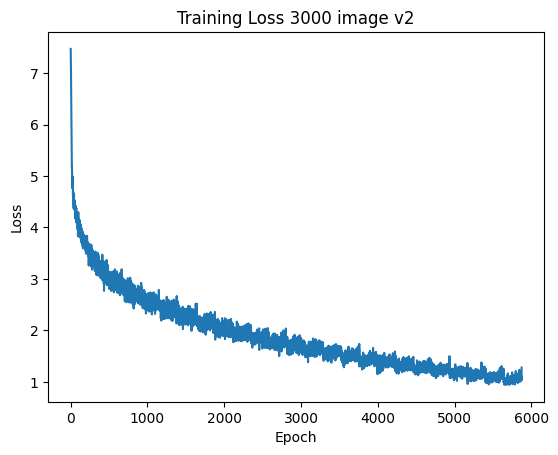

In [52]:
# 3000 v2
plt.plot(losses)
plt.title('Training Loss 3000 image v2')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.show()

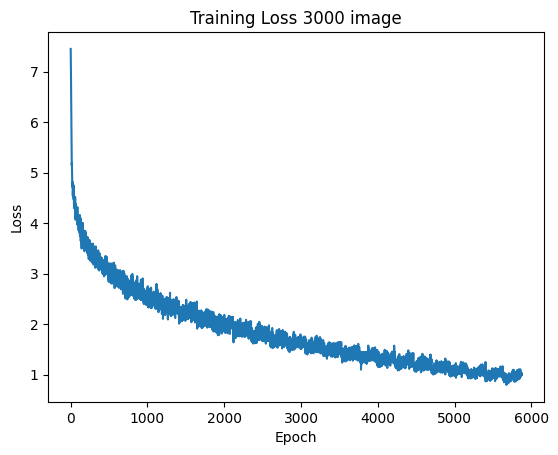

In [26]:
# 3000
plt.plot(losses)
plt.title('Training Loss 3000 image')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.show()

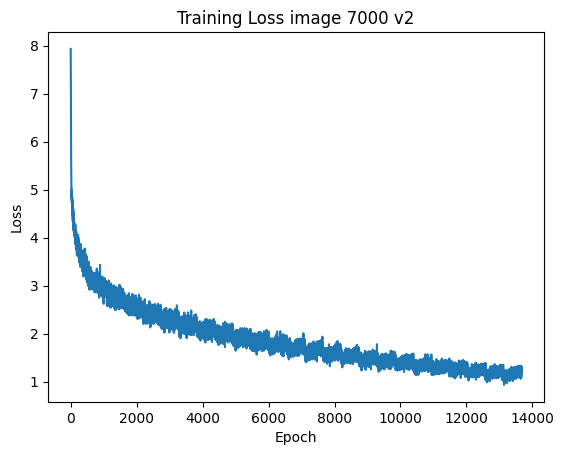

In [25]:
# 7000 image v2
plt.plot(losses)
plt.title('Training Loss image 7000 v2')
plt.xlabel('Epoch') # data_loader*BATCH_SIZE
plt.ylabel('Loss')
plt.show()

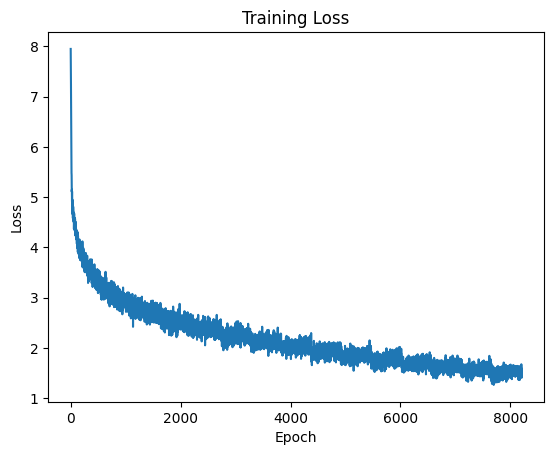

In [28]:
# 7000 image
plt.plot(losses)
plt.title('Training Loss')
plt.xlabel('Epoch') # data_loader*BATCH_SIZE
plt.ylabel('Loss')
plt.show()

BLEU score: đánh giá độ tương đồng giữa các từ và cụm từ trong câu mô tả dự đoán với các câu mô tả tham chiếu. BLEU score là trung bình điểm của n-gram precision, trong đó n thường là 1, 2, 3 hoặc 4.

METEOR score sử dụng một hàm tính điểm phức tạp hơn so với BLEU score, METEOR score đánh giá độ tương đồng giữa câu sinh ra và câu đích, sử dụng 5 câu mô tả tham chiếu cho mỗi ảnh để đánh giá độ chính xác của mô hình

In [19]:
references = [
    ['<SOS>', 'a', '.', 'throwing', 'a', 'branch', 'volleyball', 'little', 'green', 'swimming', 'dog', '<EOS>'], 
    ['<SOS>', 'a', '.', 'group', 'man', 'a', 'overlooking', 'him', 'a', 'tries', 'snow', 'to', 'a', 'warm', 'black', '<UNK>', 'little', 'with', 'the', 'green', 'dog', '<EOS>'], 
    ['<SOS>', 'a', '.', 'wearing', 'through', 'lake', 'game', 'a', '<UNK>', 'child', 'other', '<UNK>', 'man', 'dog', '<EOS>'], 
    ['<SOS>', 'a', '.', 'at', 'a', '<UNK>', 'one', 'group', 'shirt', 'a', 'branch', 'child', '<UNK>', 'man', 'green', 'dog', '<EOS>'], 
    ['<SOS>', 'on', 'hat', 'monkey', 'snow', 'a', 'snowy', '<UNK>', 'lake', 'a', '<UNK>', 'watches', '.', 'to', 'uniform', 'tree', 'wearing', 'man', 'a', 'overlooking', 'little', 'with', 'the', 'a', 'tries', '<EOS>']
]
hypotheses = [['a', 'man', 'stands', 'next', 'to', 'a', '<UNK>', '-', '<UNK>', 'food', 'in', 'front', 'of', 'a', 'building', '.', '<EOS>']]
meteor_score = nltk.translate.meteor_score.meteor_score(references, hypotheses[0])

bleu_scores = []
for reference_tokens in references:
    weights = tuple((1. / len(references),) * len(hypotheses))
    bleu_score = nltk.translate.bleu_score.sentence_bleu([reference_tokens], hypotheses[0], weights=weights, smoothing_function=smoothie)
    bleu_scores.append(bleu_score)

# Calculate average BLEU Score across all references
avg_bleu_score = np.mean(bleu_scores)

print(avg_bleu_score)
print(meteor_score)

0.7211381348792821
0.3129595588235294


In [20]:
def compute_meteor_score_bleu_score(model, test_loader):
    references = []
    hypotheses = []
    meteor_score = 0
    bleu_score = 0
    count = 0

    for image, captions in iter(test_loader):
        caption = captions.to(device)
        cap = [dataset.vocab.itos[token] for token in caption.tolist()[0]]
        i = 0
        while i < len(cap):
            if cap[i] == '<PAD>':
                del cap[i]
            else:
                i += 1
        references.append(cap)
        
        if len(references) == 5:
            with torch.no_grad():
                model.eval()
                features = model.encoder(image.to(device))
                generated_captions, alphas = model.decoder.generate_caption(features,vocab = alldata.vocab)
                hypotheses.append(generated_captions)

            meteor_score += nltk.translate.meteor_score.meteor_score(references, hypotheses[0])
            
            avg_bleu_score = []
            for reference_tokens in references:
                weights = tuple((1. / len(references),) * len(hypotheses))
                bleuscore = nltk.translate.bleu_score.sentence_bleu([reference_tokens], hypotheses[0], weights=weights, smoothing_function=smoothie)
                avg_bleu_score.append(bleuscore)

            bleu_score += np.mean(avg_bleu_score)

            references = []
            hypotheses = []
            count += 1

    print("BLEU score of datatest: {:.4f}".format(bleu_score/count))
    print("METEOR score of datatest: {:.4f}".format(meteor_score/count))


In [41]:
# 3000 image
model.load_state_dict(torch.load('attention_model_state3000_v2.pth')['state_dict'])
compute_meteor_score_bleu_score(model, test_loader)

BLEU score of datatest: 0.6358
METEOR score of datatest: 0.1834


In [42]:
model = EncoderDecoder(
    embed_size=300,
    vocab_size = len(dataset.vocab),
    attention_dim=256,
    encoder_dim=2048,
    decoder_dim=512
).to(device)

In [43]:
# 3000 image
model.load_state_dict(torch.load('attention_model_state3000.pth')['state_dict'])
compute_meteor_score_bleu_score(model, test_loader)

BLEU score of datatest: 0.4573
METEOR score of datatest: 0.0662


In [26]:
# 7000 image
model.load_state_dict(torch.load('attention_model_state_v3.pth')['state_dict'])
compute_meteor_score_bleu_score(model, test_loader)

BLEU score of datatest: 0.6295
METEOR score of datatest: 0.2622


In [27]:
model = EncoderDecoder(
    embed_size=300,
    vocab_size = len(dataset.vocab),
    attention_dim=256,
    encoder_dim=2048,
    decoder_dim=512
).to(device)

In [28]:
# 7000 image
model.load_state_dict(torch.load('attention_model_state_v2.pth')['state_dict'])
compute_meteor_score_bleu_score(model, test_loader)

BLEU score of datatest: 0.6298
METEOR score of datatest: 0.2676


In [29]:
model = EncoderDecoder(
    embed_size=300,
    vocab_size = len(dataset.vocab),
    attention_dim=256,
    encoder_dim=2048,
    decoder_dim=512
).to(device)

In [30]:
# 7000 image
model.load_state_dict(torch.load('attention_model_state.pth')['state_dict'])
compute_meteor_score_bleu_score(model, test_loader)

BLEU score of datatest: 0.2564
METEOR score of datatest: 0.0462


## Visualize Attention

In [31]:
#generate caption
def get_caps_from(features_tensors):
    #generate the caption
    model.eval()
    with torch.no_grad():
        features = model.encoder(features_tensors.to(device))
        caps,alphas = model.decoder.generate_caption(features,vocab=dataset.vocab)
        caption = ' '.join(caps)
        show_image(features_tensors[0],title=caption)
    
    return caps,alphas

In [32]:
#Show attention
def plot_attention(img, result, attention_plot):
    #untransform
    img[0] = img[0] * 0.229
    img[1] = img[1] * 0.224 
    img[2] = img[2] * 0.225 
    img[0] += 0.485 
    img[1] += 0.456 
    img[2] += 0.406
    
    print(img.shape)

    img = img.numpy().transpose((1, 2, 0))
    print(img.shape)
    temp_image = img

    fig = plt.figure(figsize=(15, 15))

    len_result = len(result)
    for l in range(len_result):
        temp_att = attention_plot[l].reshape(7,7)
        
        ax = fig.add_subplot(len_result//2,len_result//2, l+1)
        ax.set_title(result[l])
        img = ax.imshow(temp_image)
        ax.imshow(temp_att, cmap='gray', alpha=0.7, extent=img.get_extent())
        

    plt.tight_layout()
    plt.show()

### 3000 image

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


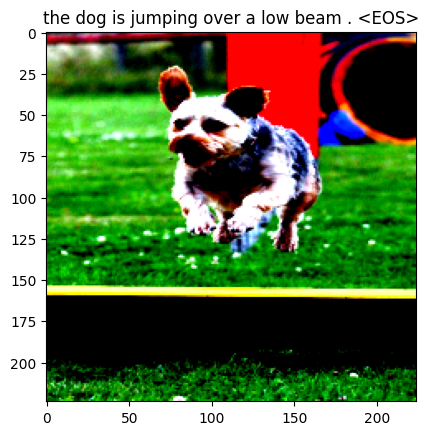

torch.Size([3, 224, 224])
(224, 224, 3)


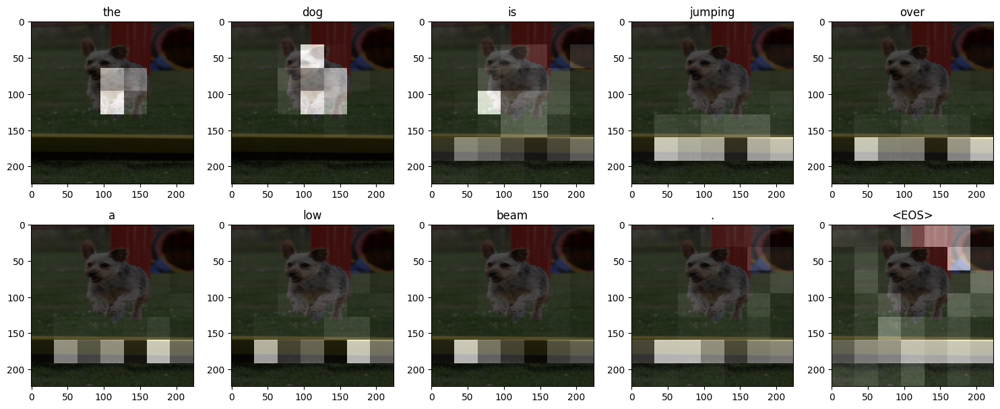

In [125]:
#show any 
dataiter = iter(data_loader)
images,_ = next(dataiter)

img = images[0].detach().clone()
img1 = images[0].detach().clone()

# Tải trọng số đã huấn luyện
model.load_state_dict(torch.load('attention_model_state3000_v2.pth')['state_dict'])

# Đánh giá model
model.eval()

caps,alphas = get_caps_from(img.unsqueeze(0))

plot_attention(img1, caps, alphas)

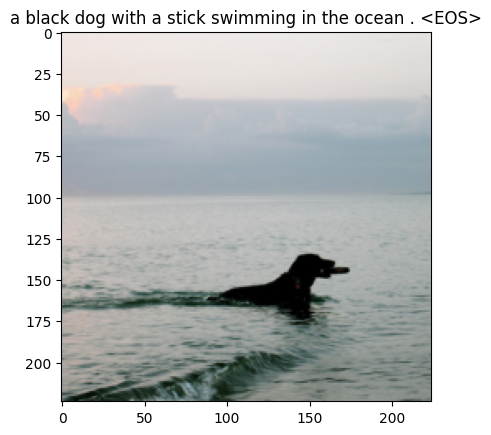

torch.Size([3, 224, 224])
(224, 224, 3)


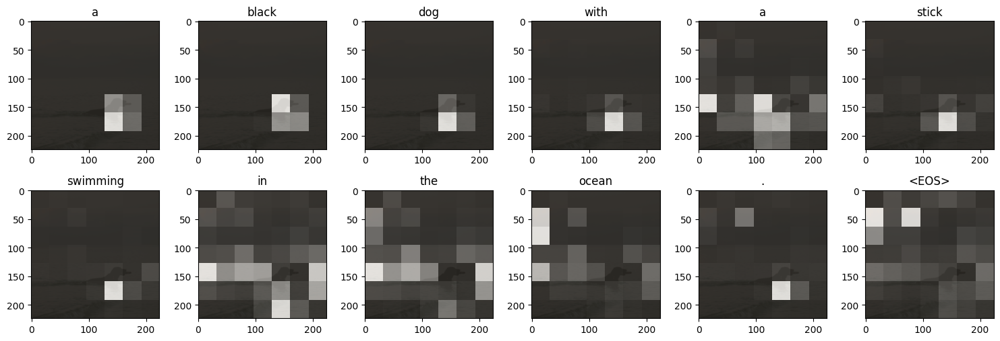

In [144]:
#show any 
dataiter = iter(data_loader)
images,_ = next(dataiter)

img = images[0].detach().clone()
img1 = images[0].detach().clone()

# Tải trọng số đã huấn luyện
model.load_state_dict(torch.load('attention_model_state3000.pth')['state_dict'])

# Đánh giá model
model.eval()

caps,alphas = get_caps_from(img.unsqueeze(0))

plot_attention(img1, caps, alphas)

### 7000 image

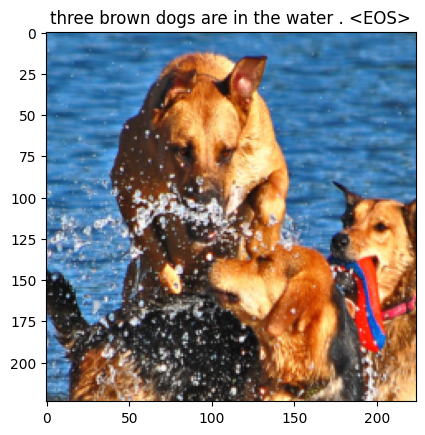

torch.Size([3, 224, 224])
(224, 224, 3)


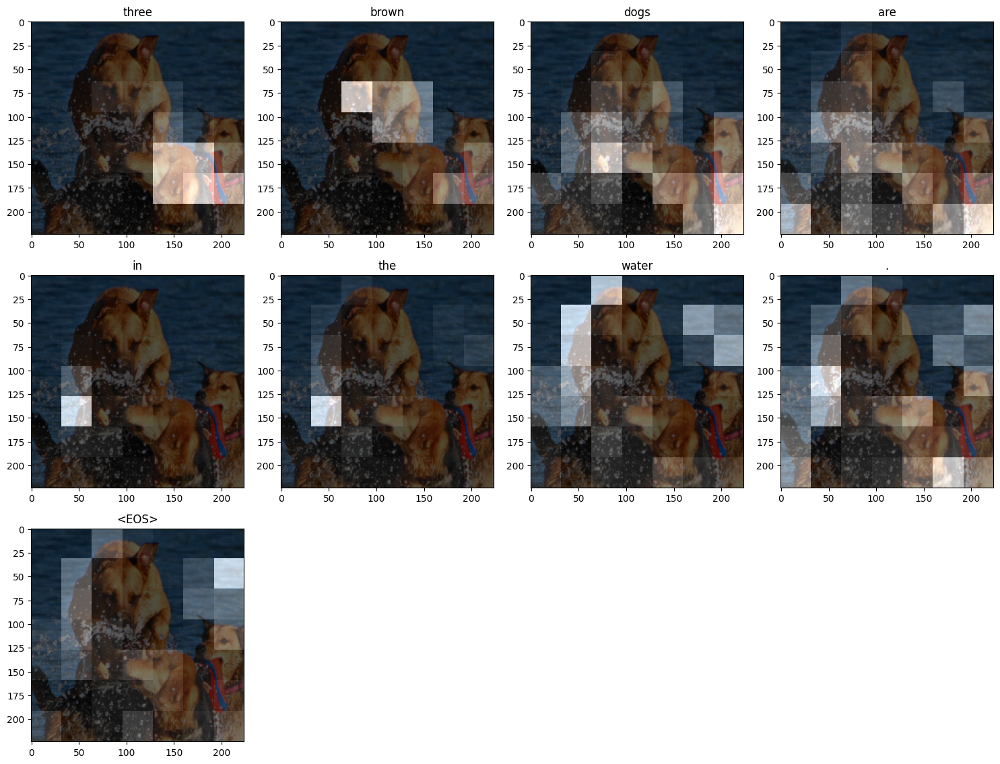

In [33]:
#show any 
dataiter = iter(data_loader)
images,_ = next(dataiter)

img = images[0].detach().clone()
img1 = images[0].detach().clone()

# Tải trọng số đã huấn luyện
model.load_state_dict(torch.load('attention_model_state_v3.pth')['state_dict'])

# Đánh giá model
model.eval()

caps,alphas = get_caps_from(img.unsqueeze(0))

plot_attention(img1, caps, alphas)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


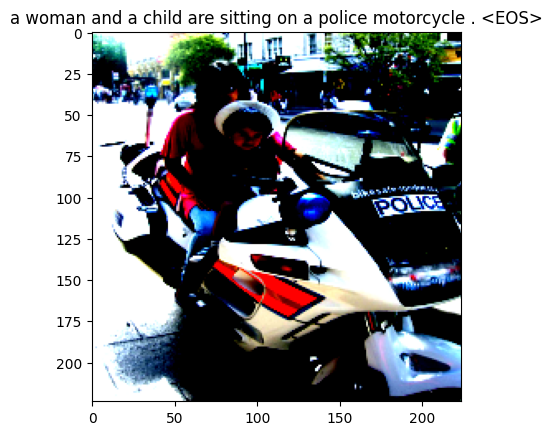

torch.Size([3, 224, 224])
(224, 224, 3)


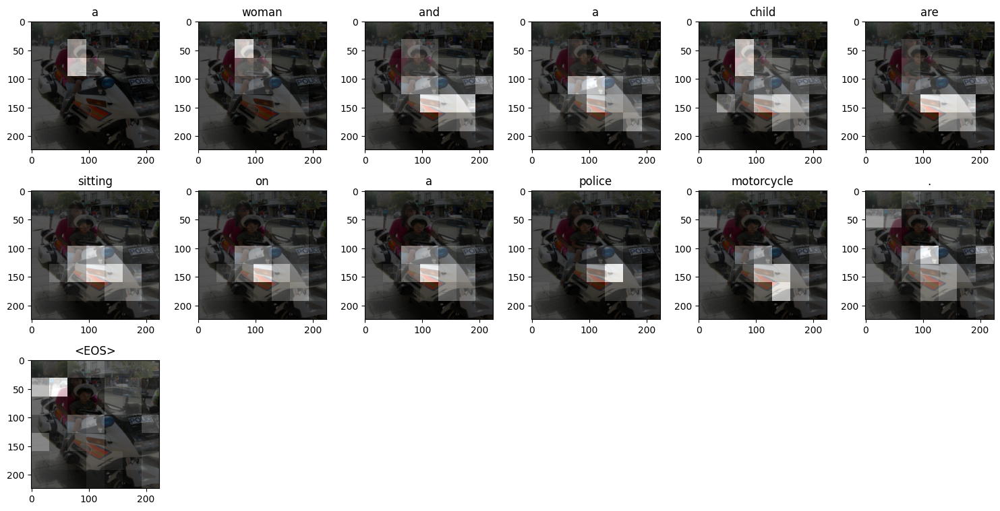

In [135]:
#show any 
dataiter = iter(data_loader)
images,_ = next(dataiter)

img = images[0].detach().clone()
img1 = images[0].detach().clone()

# Tải trọng số đã huấn luyện
model.load_state_dict(torch.load('attention_model_state_v2.pth')['state_dict'])

# Đánh giá model
model.eval()

caps,alphas = get_caps_from(img.unsqueeze(0))

plot_attention(img1, caps, alphas)

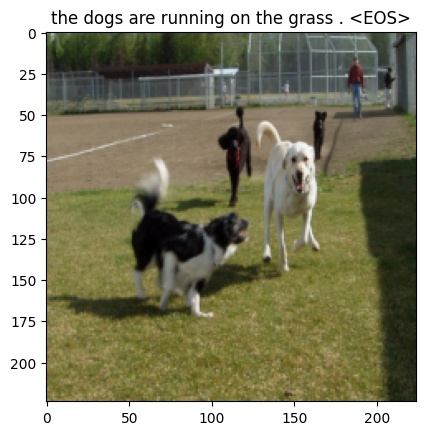

torch.Size([3, 224, 224])
(224, 224, 3)


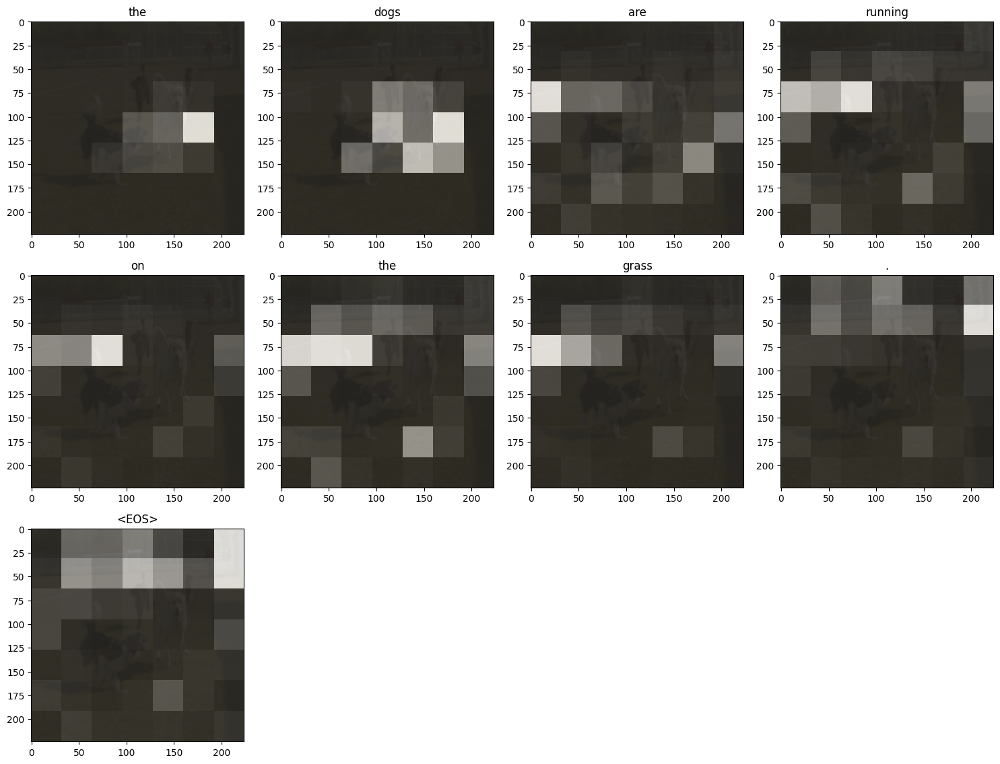

In [139]:
#show any 
dataiter = iter(data_loader)
images,_ = next(dataiter)

img = images[0].detach().clone()
img1 = images[0].detach().clone()

# Tải trọng số đã huấn luyện
model.load_state_dict(torch.load('attention_model_state.pth')['state_dict'])

# Đánh giá model
model.eval()

caps,alphas = get_caps_from(img.unsqueeze(0))

plot_attention(img1, caps, alphas)